# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

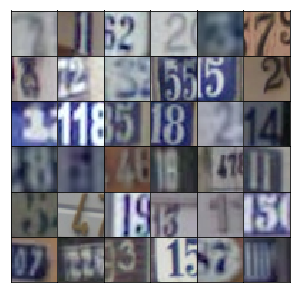

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), self.scaler(y)

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [39]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512)
        x = tf.reshape(x, (-1, 4, 4, 512))
        normalized = tf.layers.batch_normalization(x, training=training)
        # Leaky ReLU
        x = tf.maximum(alpha * normalized, normalized, "leaky_relu")
        # 4x4x512 now
        
        conv_layer1 = tf.layers.conv2d_transpose(x, 256, 5, 2, 'same')
        normalized1 = tf.layers.batch_normalization(conv_layer1, training=training)
        conv_layer1 = tf.maximum(alpha * normalized1, normalized1, "leaky_relu1")
        # 8x8x256 now
        
        conv_layer2 = tf.layers.conv2d_transpose(conv_layer1, 128, 5, 2, 'same')
        normalized2 = tf.layers.batch_normalization(conv_layer2, training=training)
        conv_layer2 = tf.maximum(alpha * normalized2, normalized2, "leaky_relu2")
        # 16x16x128 now
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(conv_layer2, output_dim, 5, 2, 'same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [72]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 64, 5, 2, 'same')
        x = tf.maximum(alpha * x, x, "leaky_relu1")
        # 16x16x64
        
        conv_layer1 = tf.layers.conv2d(x, 128, 5, 2, 'same')
        normalized1 = tf.layers.batch_normalization(conv_layer1, training=True)
        conv_layer1 = tf.maximum(alpha * normalized1, normalized1, "leaky_relu1")
        # 8x8x128
        
        conv_layer2 = tf.layers.conv2d(conv_layer1, 256, 5, 2, 'same')
        normalized2 = tf.layers.batch_normalization(conv_layer2, training=True)
        conv_layer2 = tf.maximum(alpha * normalized2, normalized2, "leaky_relu2")
        # 4x4x256
        
        # Flatten it
        flat = tf.reshape(conv_layer2, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [73]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [74]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [75]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, 0.5)

Here is a function for displaying generated images.

In [76]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an errror without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [77]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very senstive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [78]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2008... Generator Loss: 0.7725
Epoch 1/25... Discriminator Loss: 0.3385... Generator Loss: 2.1375
Epoch 1/25... Discriminator Loss: 0.1484... Generator Loss: 2.5120
Epoch 1/25... Discriminator Loss: 0.1354... Generator Loss: 2.7164
Epoch 1/25... Discriminator Loss: 0.1523... Generator Loss: 2.7844
Epoch 1/25... Discriminator Loss: 0.0830... Generator Loss: 3.3361
Epoch 1/25... Discriminator Loss: 0.1646... Generator Loss: 2.8264
Epoch 1/25... Discriminator Loss: 0.1336... Generator Loss: 3.1943
Epoch 1/25... Discriminator Loss: 0.1710... Generator Loss: 2.6941
Epoch 1/25... Discriminator Loss: 0.6513... Generator Loss: 4.2519


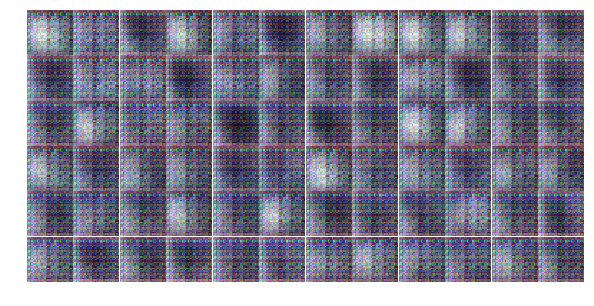

Epoch 1/25... Discriminator Loss: 0.7394... Generator Loss: 1.2295
Epoch 1/25... Discriminator Loss: 0.5726... Generator Loss: 1.8162
Epoch 1/25... Discriminator Loss: 0.4120... Generator Loss: 1.4565
Epoch 1/25... Discriminator Loss: 0.2450... Generator Loss: 2.3008
Epoch 1/25... Discriminator Loss: 0.9506... Generator Loss: 3.8136
Epoch 1/25... Discriminator Loss: 0.3734... Generator Loss: 2.1805
Epoch 1/25... Discriminator Loss: 0.0973... Generator Loss: 3.7291
Epoch 1/25... Discriminator Loss: 0.3096... Generator Loss: 2.1829
Epoch 1/25... Discriminator Loss: 0.2754... Generator Loss: 2.6200
Epoch 1/25... Discriminator Loss: 0.2258... Generator Loss: 2.3495


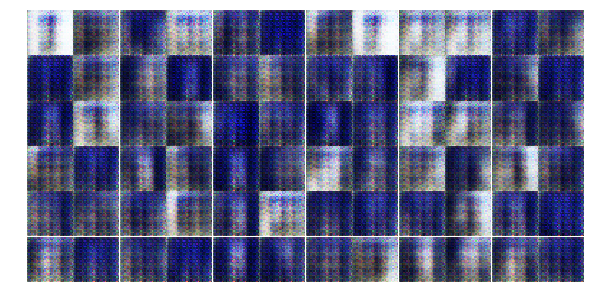

Epoch 1/25... Discriminator Loss: 0.4919... Generator Loss: 1.7098
Epoch 1/25... Discriminator Loss: 0.6269... Generator Loss: 2.7683
Epoch 1/25... Discriminator Loss: 0.4205... Generator Loss: 1.2724
Epoch 1/25... Discriminator Loss: 0.0631... Generator Loss: 4.8726
Epoch 1/25... Discriminator Loss: 0.6118... Generator Loss: 1.2840
Epoch 1/25... Discriminator Loss: 0.2290... Generator Loss: 2.2154
Epoch 1/25... Discriminator Loss: 0.2626... Generator Loss: 2.3985
Epoch 1/25... Discriminator Loss: 0.7356... Generator Loss: 1.5511
Epoch 1/25... Discriminator Loss: 0.8900... Generator Loss: 2.2179
Epoch 1/25... Discriminator Loss: 0.8381... Generator Loss: 1.8576


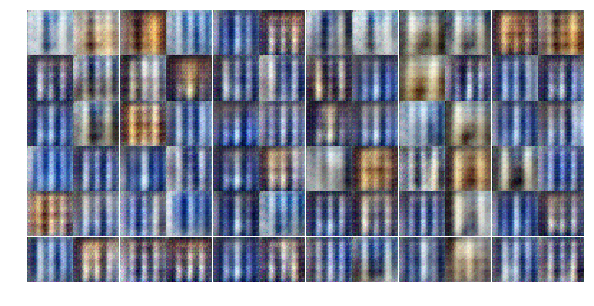

Epoch 1/25... Discriminator Loss: 0.6958... Generator Loss: 1.8770
Epoch 1/25... Discriminator Loss: 0.9578... Generator Loss: 0.7615
Epoch 1/25... Discriminator Loss: 0.7826... Generator Loss: 1.4967
Epoch 1/25... Discriminator Loss: 0.5986... Generator Loss: 1.4084
Epoch 1/25... Discriminator Loss: 0.8838... Generator Loss: 1.1348
Epoch 1/25... Discriminator Loss: 0.7115... Generator Loss: 1.4595
Epoch 1/25... Discriminator Loss: 0.6573... Generator Loss: 1.1987
Epoch 1/25... Discriminator Loss: 0.4353... Generator Loss: 2.6355
Epoch 1/25... Discriminator Loss: 0.4330... Generator Loss: 2.1609
Epoch 1/25... Discriminator Loss: 0.6649... Generator Loss: 1.3073


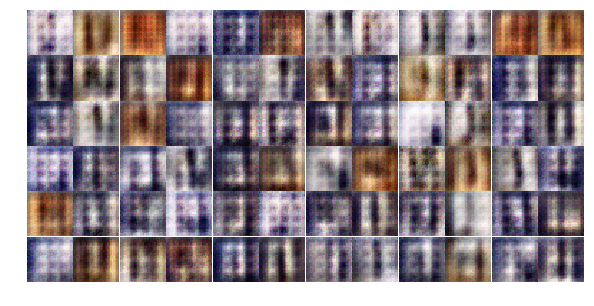

Epoch 1/25... Discriminator Loss: 0.6548... Generator Loss: 1.6337
Epoch 1/25... Discriminator Loss: 0.6891... Generator Loss: 1.1084
Epoch 1/25... Discriminator Loss: 0.4204... Generator Loss: 1.8764
Epoch 1/25... Discriminator Loss: 0.3661... Generator Loss: 2.3018
Epoch 1/25... Discriminator Loss: 0.7572... Generator Loss: 1.4370
Epoch 1/25... Discriminator Loss: 0.5004... Generator Loss: 1.5608
Epoch 1/25... Discriminator Loss: 0.3265... Generator Loss: 2.1168
Epoch 1/25... Discriminator Loss: 0.4957... Generator Loss: 1.6221
Epoch 1/25... Discriminator Loss: 0.6627... Generator Loss: 1.3119
Epoch 1/25... Discriminator Loss: 0.6066... Generator Loss: 2.5357


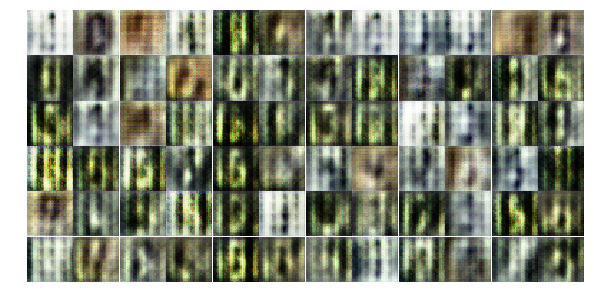

Epoch 1/25... Discriminator Loss: 0.5493... Generator Loss: 2.0487
Epoch 1/25... Discriminator Loss: 0.9016... Generator Loss: 2.4365
Epoch 1/25... Discriminator Loss: 0.5990... Generator Loss: 1.5970
Epoch 1/25... Discriminator Loss: 1.1206... Generator Loss: 0.6809
Epoch 1/25... Discriminator Loss: 0.7873... Generator Loss: 1.2614
Epoch 1/25... Discriminator Loss: 0.6220... Generator Loss: 1.1138
Epoch 1/25... Discriminator Loss: 0.5116... Generator Loss: 1.6690
Epoch 2/25... Discriminator Loss: 0.8052... Generator Loss: 1.0412
Epoch 2/25... Discriminator Loss: 0.7498... Generator Loss: 2.0008
Epoch 2/25... Discriminator Loss: 0.9112... Generator Loss: 1.1489


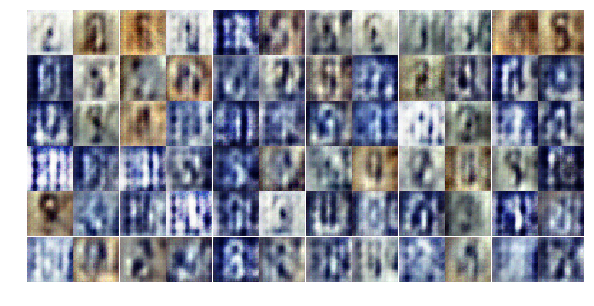

Epoch 2/25... Discriminator Loss: 0.8269... Generator Loss: 1.6807
Epoch 2/25... Discriminator Loss: 0.8749... Generator Loss: 1.0731
Epoch 2/25... Discriminator Loss: 0.9425... Generator Loss: 0.9659
Epoch 2/25... Discriminator Loss: 0.9256... Generator Loss: 1.3137
Epoch 2/25... Discriminator Loss: 0.9246... Generator Loss: 1.1497
Epoch 2/25... Discriminator Loss: 1.3431... Generator Loss: 0.6192
Epoch 2/25... Discriminator Loss: 0.8950... Generator Loss: 1.1983
Epoch 2/25... Discriminator Loss: 1.0318... Generator Loss: 0.7806
Epoch 2/25... Discriminator Loss: 0.8333... Generator Loss: 1.1941
Epoch 2/25... Discriminator Loss: 1.1380... Generator Loss: 1.6880


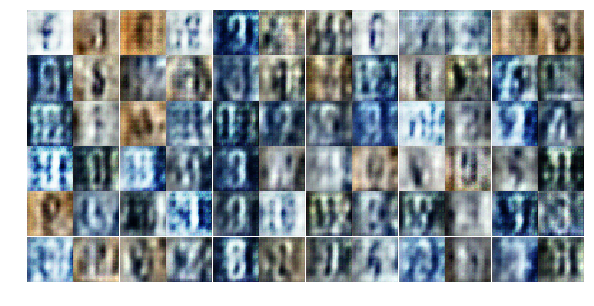

Epoch 2/25... Discriminator Loss: 1.4360... Generator Loss: 0.7821
Epoch 2/25... Discriminator Loss: 0.9749... Generator Loss: 0.8987
Epoch 2/25... Discriminator Loss: 0.8681... Generator Loss: 1.2745
Epoch 2/25... Discriminator Loss: 0.4923... Generator Loss: 1.8281
Epoch 2/25... Discriminator Loss: 0.9941... Generator Loss: 1.2939
Epoch 2/25... Discriminator Loss: 1.1298... Generator Loss: 1.1127
Epoch 2/25... Discriminator Loss: 1.0189... Generator Loss: 1.0606
Epoch 2/25... Discriminator Loss: 1.5078... Generator Loss: 0.8209
Epoch 2/25... Discriminator Loss: 0.9450... Generator Loss: 1.1456
Epoch 2/25... Discriminator Loss: 1.3178... Generator Loss: 0.7458


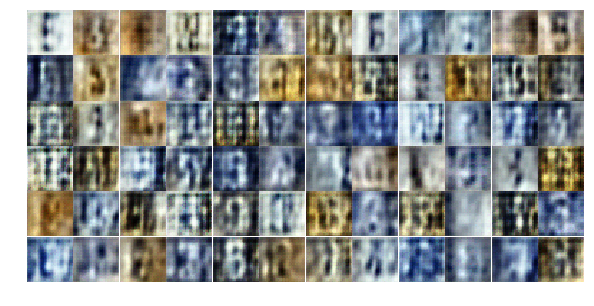

Epoch 2/25... Discriminator Loss: 1.2668... Generator Loss: 0.7525
Epoch 2/25... Discriminator Loss: 1.0340... Generator Loss: 1.3963
Epoch 2/25... Discriminator Loss: 0.8922... Generator Loss: 1.2309
Epoch 2/25... Discriminator Loss: 0.9948... Generator Loss: 1.3417
Epoch 2/25... Discriminator Loss: 1.0103... Generator Loss: 1.0189
Epoch 2/25... Discriminator Loss: 1.0323... Generator Loss: 1.0202
Epoch 2/25... Discriminator Loss: 1.1065... Generator Loss: 0.6629
Epoch 2/25... Discriminator Loss: 1.2268... Generator Loss: 0.7489
Epoch 2/25... Discriminator Loss: 1.1042... Generator Loss: 0.9065
Epoch 2/25... Discriminator Loss: 0.8776... Generator Loss: 1.3742


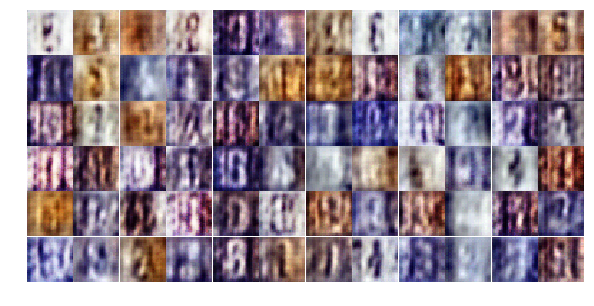

Epoch 2/25... Discriminator Loss: 1.0349... Generator Loss: 1.0205
Epoch 2/25... Discriminator Loss: 1.4492... Generator Loss: 0.7977
Epoch 2/25... Discriminator Loss: 1.2542... Generator Loss: 0.8331
Epoch 2/25... Discriminator Loss: 1.3034... Generator Loss: 0.5764
Epoch 2/25... Discriminator Loss: 0.9708... Generator Loss: 1.1119
Epoch 2/25... Discriminator Loss: 0.9332... Generator Loss: 1.0392
Epoch 2/25... Discriminator Loss: 1.0278... Generator Loss: 0.9383
Epoch 2/25... Discriminator Loss: 1.1089... Generator Loss: 1.7953
Epoch 2/25... Discriminator Loss: 1.2249... Generator Loss: 1.0762
Epoch 2/25... Discriminator Loss: 1.1045... Generator Loss: 1.1021


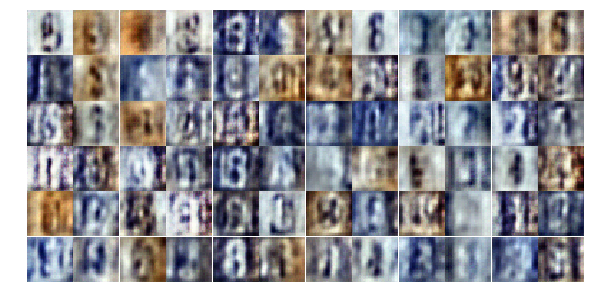

Epoch 2/25... Discriminator Loss: 0.9156... Generator Loss: 1.2767
Epoch 2/25... Discriminator Loss: 1.3637... Generator Loss: 0.6412
Epoch 2/25... Discriminator Loss: 1.1774... Generator Loss: 0.5191
Epoch 2/25... Discriminator Loss: 1.1250... Generator Loss: 1.0662
Epoch 2/25... Discriminator Loss: 1.1924... Generator Loss: 0.9280
Epoch 2/25... Discriminator Loss: 1.2328... Generator Loss: 0.6090
Epoch 2/25... Discriminator Loss: 0.7929... Generator Loss: 1.1290
Epoch 2/25... Discriminator Loss: 1.1153... Generator Loss: 0.9805
Epoch 2/25... Discriminator Loss: 0.8816... Generator Loss: 1.2850
Epoch 2/25... Discriminator Loss: 1.0326... Generator Loss: 1.1259


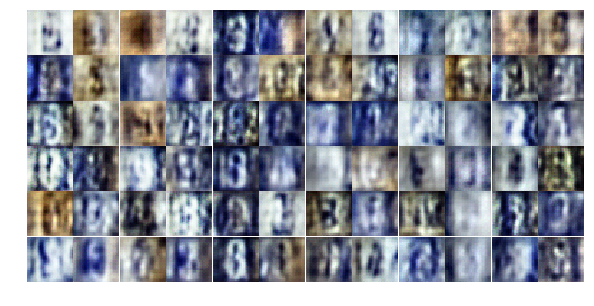

Epoch 2/25... Discriminator Loss: 1.3366... Generator Loss: 0.8833
Epoch 2/25... Discriminator Loss: 1.1565... Generator Loss: 1.1370
Epoch 2/25... Discriminator Loss: 1.0605... Generator Loss: 0.7201
Epoch 2/25... Discriminator Loss: 0.7829... Generator Loss: 1.1911
Epoch 3/25... Discriminator Loss: 0.9829... Generator Loss: 1.4703
Epoch 3/25... Discriminator Loss: 0.9701... Generator Loss: 0.9797
Epoch 3/25... Discriminator Loss: 1.0912... Generator Loss: 0.8607
Epoch 3/25... Discriminator Loss: 0.8118... Generator Loss: 1.0551
Epoch 3/25... Discriminator Loss: 0.9790... Generator Loss: 1.1634
Epoch 3/25... Discriminator Loss: 1.1631... Generator Loss: 0.8570


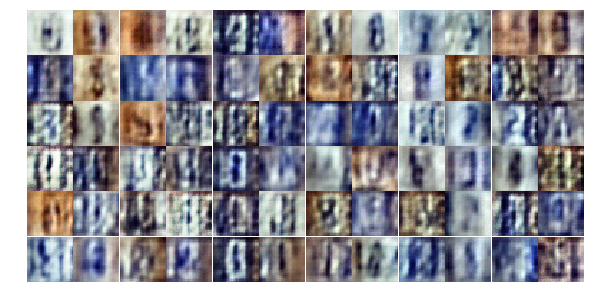

Epoch 3/25... Discriminator Loss: 0.7952... Generator Loss: 1.4943
Epoch 3/25... Discriminator Loss: 1.5937... Generator Loss: 1.3699
Epoch 3/25... Discriminator Loss: 0.7268... Generator Loss: 1.1030
Epoch 3/25... Discriminator Loss: 0.8410... Generator Loss: 1.4042
Epoch 3/25... Discriminator Loss: 0.9652... Generator Loss: 0.9026
Epoch 3/25... Discriminator Loss: 1.0383... Generator Loss: 1.0002
Epoch 3/25... Discriminator Loss: 0.9364... Generator Loss: 0.9404
Epoch 3/25... Discriminator Loss: 0.7534... Generator Loss: 1.0760
Epoch 3/25... Discriminator Loss: 0.8124... Generator Loss: 1.3442
Epoch 3/25... Discriminator Loss: 0.8502... Generator Loss: 0.8795


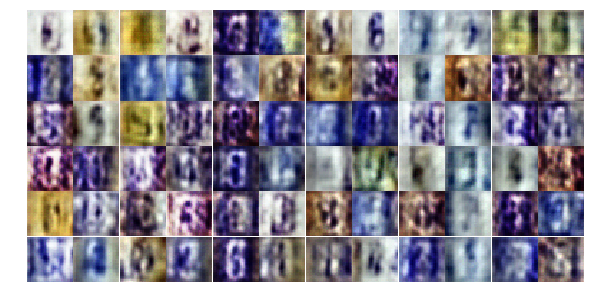

Epoch 3/25... Discriminator Loss: 1.1129... Generator Loss: 0.9694
Epoch 3/25... Discriminator Loss: 1.0905... Generator Loss: 0.6507
Epoch 3/25... Discriminator Loss: 0.7132... Generator Loss: 1.4129
Epoch 3/25... Discriminator Loss: 0.8565... Generator Loss: 1.1944
Epoch 3/25... Discriminator Loss: 0.7664... Generator Loss: 1.1086
Epoch 3/25... Discriminator Loss: 0.5353... Generator Loss: 2.1751
Epoch 3/25... Discriminator Loss: 0.4658... Generator Loss: 1.6021
Epoch 3/25... Discriminator Loss: 0.8187... Generator Loss: 0.8881
Epoch 3/25... Discriminator Loss: 0.6746... Generator Loss: 1.4235
Epoch 3/25... Discriminator Loss: 0.8932... Generator Loss: 0.8994


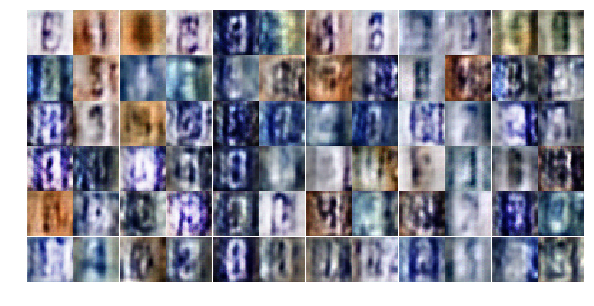

Epoch 3/25... Discriminator Loss: 0.7528... Generator Loss: 0.9301
Epoch 3/25... Discriminator Loss: 0.8084... Generator Loss: 1.1588
Epoch 3/25... Discriminator Loss: 0.6249... Generator Loss: 1.3368
Epoch 3/25... Discriminator Loss: 0.7415... Generator Loss: 1.6679
Epoch 3/25... Discriminator Loss: 0.8428... Generator Loss: 1.3495
Epoch 3/25... Discriminator Loss: 0.5107... Generator Loss: 1.7955
Epoch 3/25... Discriminator Loss: 1.1013... Generator Loss: 0.5618
Epoch 3/25... Discriminator Loss: 0.4730... Generator Loss: 1.8113
Epoch 3/25... Discriminator Loss: 1.6770... Generator Loss: 3.6443
Epoch 3/25... Discriminator Loss: 1.1200... Generator Loss: 0.6017


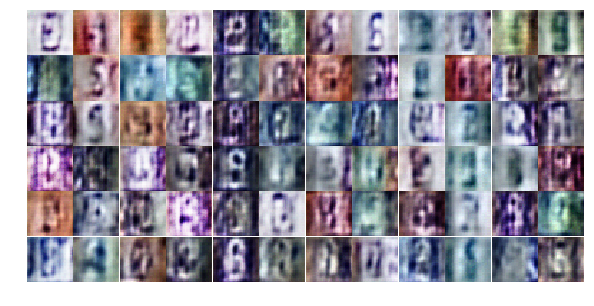

Epoch 3/25... Discriminator Loss: 0.4762... Generator Loss: 1.7531
Epoch 3/25... Discriminator Loss: 1.0416... Generator Loss: 0.7532
Epoch 3/25... Discriminator Loss: 0.7225... Generator Loss: 1.2427
Epoch 3/25... Discriminator Loss: 0.9080... Generator Loss: 0.8935
Epoch 3/25... Discriminator Loss: 0.5974... Generator Loss: 1.5435
Epoch 3/25... Discriminator Loss: 0.8020... Generator Loss: 0.8748
Epoch 3/25... Discriminator Loss: 0.9822... Generator Loss: 0.8155
Epoch 3/25... Discriminator Loss: 0.6191... Generator Loss: 1.8648
Epoch 3/25... Discriminator Loss: 0.9536... Generator Loss: 2.8791
Epoch 3/25... Discriminator Loss: 0.9002... Generator Loss: 0.8531


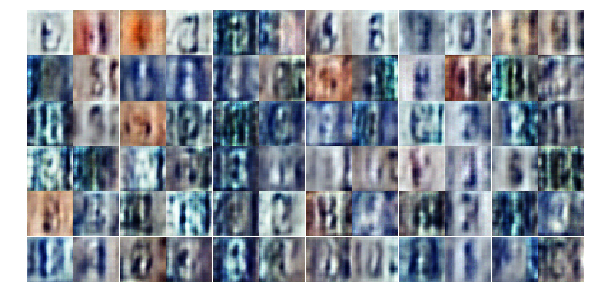

Epoch 3/25... Discriminator Loss: 0.4951... Generator Loss: 1.5618
Epoch 3/25... Discriminator Loss: 0.8822... Generator Loss: 1.4416
Epoch 3/25... Discriminator Loss: 0.6106... Generator Loss: 1.2672
Epoch 3/25... Discriminator Loss: 0.4457... Generator Loss: 2.0252
Epoch 3/25... Discriminator Loss: 0.7845... Generator Loss: 2.2435
Epoch 3/25... Discriminator Loss: 0.4559... Generator Loss: 2.0536
Epoch 3/25... Discriminator Loss: 0.5673... Generator Loss: 1.4943
Epoch 3/25... Discriminator Loss: 0.6424... Generator Loss: 1.3409
Epoch 3/25... Discriminator Loss: 0.5261... Generator Loss: 1.6637
Epoch 3/25... Discriminator Loss: 0.4842... Generator Loss: 1.7687


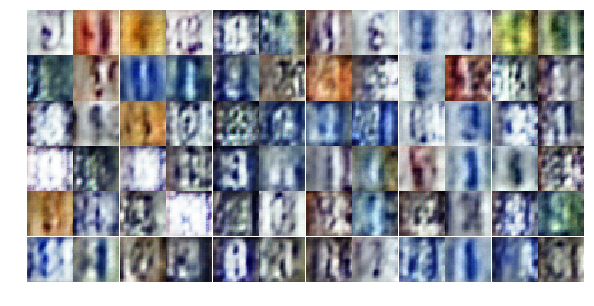

Epoch 3/25... Discriminator Loss: 0.6041... Generator Loss: 1.8825
Epoch 4/25... Discriminator Loss: 0.5700... Generator Loss: 1.3757
Epoch 4/25... Discriminator Loss: 0.7903... Generator Loss: 1.8008
Epoch 4/25... Discriminator Loss: 0.5667... Generator Loss: 1.3000
Epoch 4/25... Discriminator Loss: 0.4480... Generator Loss: 1.6849
Epoch 4/25... Discriminator Loss: 0.5089... Generator Loss: 1.3597
Epoch 4/25... Discriminator Loss: 0.4054... Generator Loss: 2.1999
Epoch 4/25... Discriminator Loss: 0.4893... Generator Loss: 1.8695
Epoch 4/25... Discriminator Loss: 0.2360... Generator Loss: 3.4202
Epoch 4/25... Discriminator Loss: 0.3856... Generator Loss: 1.8130


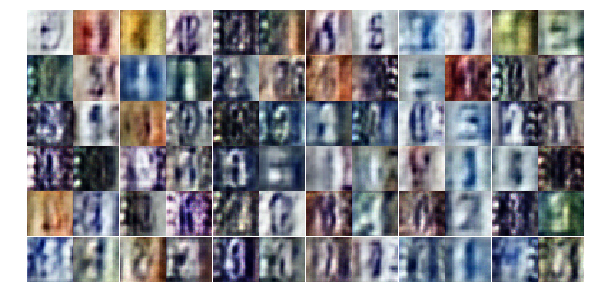

Epoch 4/25... Discriminator Loss: 0.5005... Generator Loss: 2.7646
Epoch 4/25... Discriminator Loss: 0.5303... Generator Loss: 1.6514
Epoch 4/25... Discriminator Loss: 0.7216... Generator Loss: 1.5472
Epoch 4/25... Discriminator Loss: 0.5894... Generator Loss: 1.3828
Epoch 4/25... Discriminator Loss: 0.9702... Generator Loss: 0.6624
Epoch 4/25... Discriminator Loss: 0.9404... Generator Loss: 0.8694
Epoch 4/25... Discriminator Loss: 1.3069... Generator Loss: 1.0161
Epoch 4/25... Discriminator Loss: 1.8947... Generator Loss: 0.2354
Epoch 4/25... Discriminator Loss: 0.6221... Generator Loss: 1.4735
Epoch 4/25... Discriminator Loss: 0.7614... Generator Loss: 1.1076


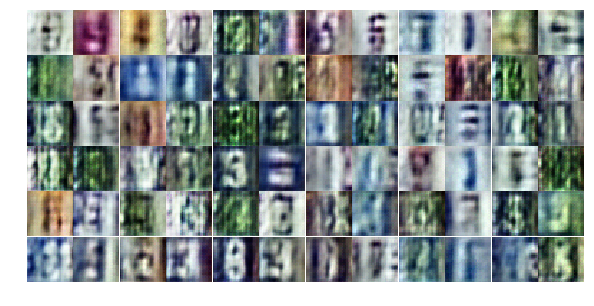

Epoch 4/25... Discriminator Loss: 0.7659... Generator Loss: 2.4798
Epoch 4/25... Discriminator Loss: 0.7488... Generator Loss: 1.0245
Epoch 4/25... Discriminator Loss: 0.8692... Generator Loss: 0.9604
Epoch 4/25... Discriminator Loss: 0.6012... Generator Loss: 1.5988
Epoch 4/25... Discriminator Loss: 0.8771... Generator Loss: 0.9966
Epoch 4/25... Discriminator Loss: 0.5526... Generator Loss: 2.6468
Epoch 4/25... Discriminator Loss: 1.7322... Generator Loss: 0.3151
Epoch 4/25... Discriminator Loss: 1.1205... Generator Loss: 0.5927
Epoch 4/25... Discriminator Loss: 1.1109... Generator Loss: 0.7266
Epoch 4/25... Discriminator Loss: 0.5673... Generator Loss: 1.1880


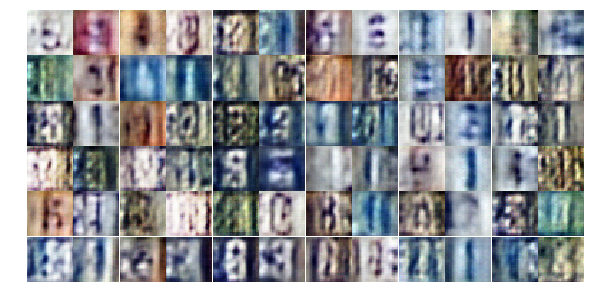

Epoch 4/25... Discriminator Loss: 0.5153... Generator Loss: 1.3129
Epoch 4/25... Discriminator Loss: 0.7663... Generator Loss: 1.7013
Epoch 4/25... Discriminator Loss: 0.8220... Generator Loss: 1.8236
Epoch 4/25... Discriminator Loss: 0.5957... Generator Loss: 1.4576
Epoch 4/25... Discriminator Loss: 0.5232... Generator Loss: 1.7212
Epoch 4/25... Discriminator Loss: 0.4751... Generator Loss: 2.0947
Epoch 4/25... Discriminator Loss: 0.5629... Generator Loss: 1.2921
Epoch 4/25... Discriminator Loss: 0.7253... Generator Loss: 1.1013
Epoch 4/25... Discriminator Loss: 0.5459... Generator Loss: 1.3115
Epoch 4/25... Discriminator Loss: 0.6776... Generator Loss: 1.0280


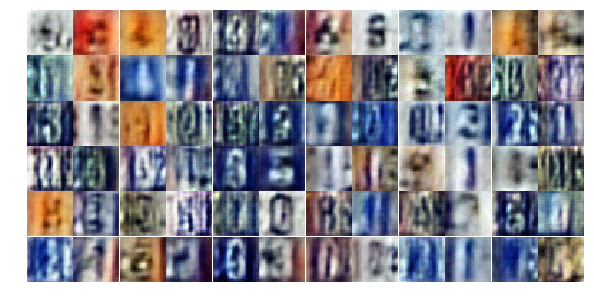

Epoch 4/25... Discriminator Loss: 1.0188... Generator Loss: 0.6640
Epoch 4/25... Discriminator Loss: 0.2849... Generator Loss: 3.1538
Epoch 4/25... Discriminator Loss: 0.5466... Generator Loss: 1.6233
Epoch 4/25... Discriminator Loss: 0.5553... Generator Loss: 2.5678
Epoch 4/25... Discriminator Loss: 0.6593... Generator Loss: 1.1371
Epoch 4/25... Discriminator Loss: 0.8965... Generator Loss: 0.7937
Epoch 4/25... Discriminator Loss: 0.5906... Generator Loss: 1.3290
Epoch 4/25... Discriminator Loss: 0.6513... Generator Loss: 1.0654
Epoch 4/25... Discriminator Loss: 0.9556... Generator Loss: 0.6585
Epoch 4/25... Discriminator Loss: 0.5017... Generator Loss: 1.5025


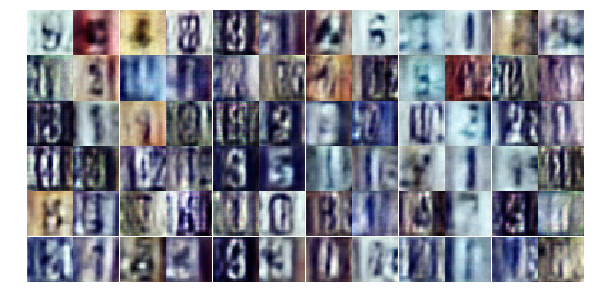

Epoch 4/25... Discriminator Loss: 0.5390... Generator Loss: 2.2065
Epoch 4/25... Discriminator Loss: 0.9203... Generator Loss: 1.0354
Epoch 4/25... Discriminator Loss: 0.6554... Generator Loss: 2.8303
Epoch 4/25... Discriminator Loss: 0.7082... Generator Loss: 3.1063
Epoch 4/25... Discriminator Loss: 0.9746... Generator Loss: 0.7800
Epoch 4/25... Discriminator Loss: 0.6164... Generator Loss: 1.6972
Epoch 4/25... Discriminator Loss: 0.4779... Generator Loss: 1.3466
Epoch 4/25... Discriminator Loss: 0.5533... Generator Loss: 1.2423
Epoch 4/25... Discriminator Loss: 0.5843... Generator Loss: 1.8904
Epoch 5/25... Discriminator Loss: 1.4466... Generator Loss: 3.6963


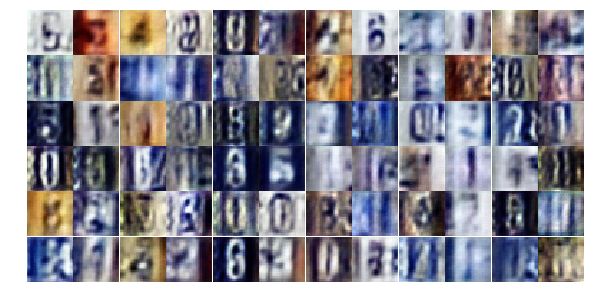

Epoch 5/25... Discriminator Loss: 0.6151... Generator Loss: 1.1624
Epoch 5/25... Discriminator Loss: 0.3982... Generator Loss: 1.6423
Epoch 5/25... Discriminator Loss: 0.7242... Generator Loss: 0.9799
Epoch 5/25... Discriminator Loss: 0.4667... Generator Loss: 2.6948
Epoch 5/25... Discriminator Loss: 0.9504... Generator Loss: 2.9472
Epoch 5/25... Discriminator Loss: 0.4921... Generator Loss: 1.7261
Epoch 5/25... Discriminator Loss: 0.5693... Generator Loss: 1.3517
Epoch 5/25... Discriminator Loss: 0.6480... Generator Loss: 1.0447
Epoch 5/25... Discriminator Loss: 0.4036... Generator Loss: 2.0459
Epoch 5/25... Discriminator Loss: 0.9866... Generator Loss: 0.6384


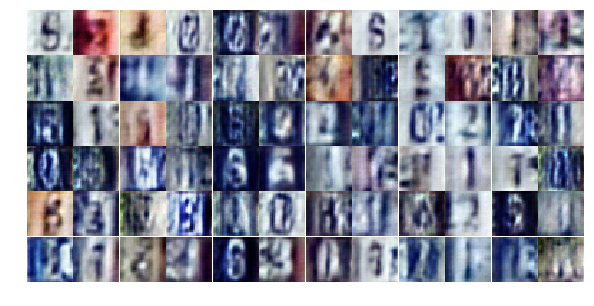

Epoch 5/25... Discriminator Loss: 0.4468... Generator Loss: 1.8749
Epoch 5/25... Discriminator Loss: 0.4681... Generator Loss: 1.5229
Epoch 5/25... Discriminator Loss: 0.5187... Generator Loss: 1.2677
Epoch 5/25... Discriminator Loss: 1.1073... Generator Loss: 0.5366
Epoch 5/25... Discriminator Loss: 0.7586... Generator Loss: 2.0700
Epoch 5/25... Discriminator Loss: 0.8802... Generator Loss: 0.9703
Epoch 5/25... Discriminator Loss: 0.5175... Generator Loss: 1.4474
Epoch 5/25... Discriminator Loss: 0.6180... Generator Loss: 1.2583
Epoch 5/25... Discriminator Loss: 0.4018... Generator Loss: 1.6004
Epoch 5/25... Discriminator Loss: 0.3202... Generator Loss: 1.8914


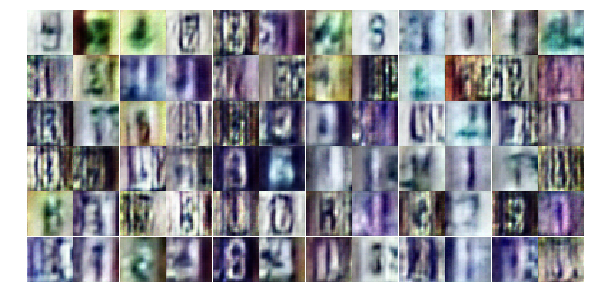

Epoch 5/25... Discriminator Loss: 0.4484... Generator Loss: 1.4155
Epoch 5/25... Discriminator Loss: 0.6041... Generator Loss: 1.4138
Epoch 5/25... Discriminator Loss: 0.6312... Generator Loss: 1.2594
Epoch 5/25... Discriminator Loss: 1.2403... Generator Loss: 0.6433
Epoch 5/25... Discriminator Loss: 1.4484... Generator Loss: 0.3953
Epoch 5/25... Discriminator Loss: 0.6904... Generator Loss: 1.0014
Epoch 5/25... Discriminator Loss: 0.7429... Generator Loss: 0.9873
Epoch 5/25... Discriminator Loss: 0.5253... Generator Loss: 1.3600
Epoch 5/25... Discriminator Loss: 0.3471... Generator Loss: 1.8136
Epoch 5/25... Discriminator Loss: 0.3916... Generator Loss: 1.4823


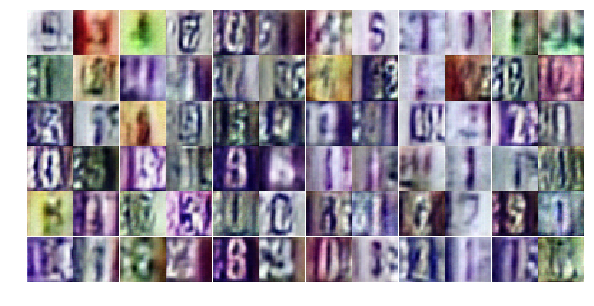

Epoch 5/25... Discriminator Loss: 0.7561... Generator Loss: 1.2337
Epoch 5/25... Discriminator Loss: 2.1098... Generator Loss: 0.1819
Epoch 5/25... Discriminator Loss: 0.7470... Generator Loss: 2.3390
Epoch 5/25... Discriminator Loss: 0.6779... Generator Loss: 1.1429
Epoch 5/25... Discriminator Loss: 1.3728... Generator Loss: 4.1826
Epoch 5/25... Discriminator Loss: 0.3940... Generator Loss: 1.8140
Epoch 5/25... Discriminator Loss: 0.5441... Generator Loss: 1.5940
Epoch 5/25... Discriminator Loss: 0.5797... Generator Loss: 1.2042
Epoch 5/25... Discriminator Loss: 0.6855... Generator Loss: 0.9548
Epoch 5/25... Discriminator Loss: 0.3835... Generator Loss: 2.0029


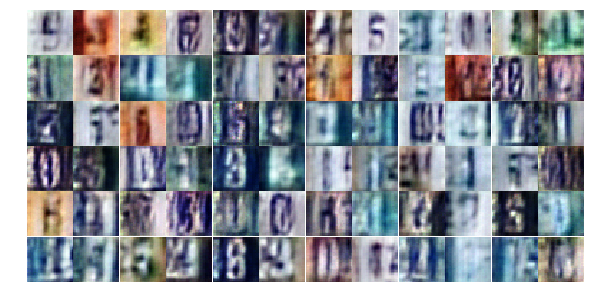

Epoch 5/25... Discriminator Loss: 0.2891... Generator Loss: 2.5902
Epoch 5/25... Discriminator Loss: 0.5672... Generator Loss: 1.0852
Epoch 5/25... Discriminator Loss: 0.6426... Generator Loss: 1.2129
Epoch 5/25... Discriminator Loss: 0.6091... Generator Loss: 3.1874
Epoch 5/25... Discriminator Loss: 0.7480... Generator Loss: 1.0505
Epoch 5/25... Discriminator Loss: 0.7643... Generator Loss: 0.8976
Epoch 5/25... Discriminator Loss: 0.5492... Generator Loss: 1.2087
Epoch 5/25... Discriminator Loss: 0.3909... Generator Loss: 1.9828
Epoch 5/25... Discriminator Loss: 1.0704... Generator Loss: 0.5709
Epoch 5/25... Discriminator Loss: 0.8998... Generator Loss: 3.5430


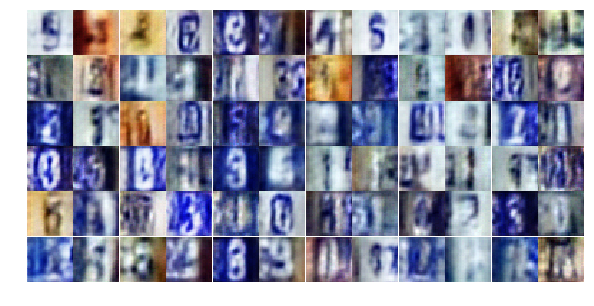

Epoch 5/25... Discriminator Loss: 1.1080... Generator Loss: 0.6866
Epoch 5/25... Discriminator Loss: 0.9272... Generator Loss: 0.7078
Epoch 5/25... Discriminator Loss: 0.8553... Generator Loss: 0.8263
Epoch 5/25... Discriminator Loss: 0.8081... Generator Loss: 0.8409
Epoch 5/25... Discriminator Loss: 0.4367... Generator Loss: 1.7155
Epoch 5/25... Discriminator Loss: 0.6860... Generator Loss: 1.5087
Epoch 6/25... Discriminator Loss: 0.4068... Generator Loss: 1.6290
Epoch 6/25... Discriminator Loss: 0.4537... Generator Loss: 1.4220
Epoch 6/25... Discriminator Loss: 0.5019... Generator Loss: 1.7384
Epoch 6/25... Discriminator Loss: 0.5934... Generator Loss: 1.5642


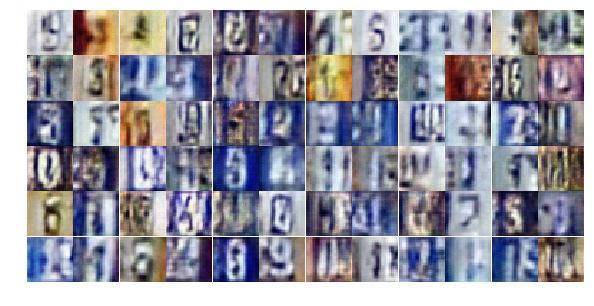

Epoch 6/25... Discriminator Loss: 0.5345... Generator Loss: 1.3519
Epoch 6/25... Discriminator Loss: 1.1846... Generator Loss: 0.5227
Epoch 6/25... Discriminator Loss: 0.6490... Generator Loss: 1.3542
Epoch 6/25... Discriminator Loss: 0.7831... Generator Loss: 1.1311
Epoch 6/25... Discriminator Loss: 0.7275... Generator Loss: 1.3328
Epoch 6/25... Discriminator Loss: 0.4964... Generator Loss: 1.4773
Epoch 6/25... Discriminator Loss: 0.4327... Generator Loss: 1.5675
Epoch 6/25... Discriminator Loss: 0.8033... Generator Loss: 0.9506
Epoch 6/25... Discriminator Loss: 0.6591... Generator Loss: 1.3050
Epoch 6/25... Discriminator Loss: 1.0544... Generator Loss: 0.6768


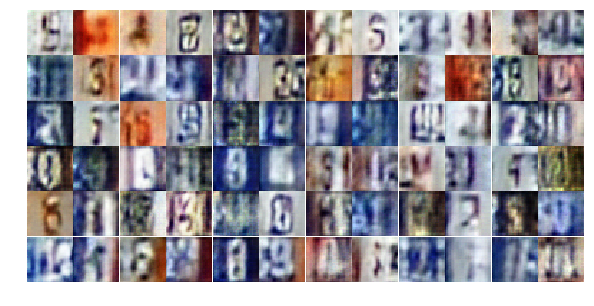

Epoch 6/25... Discriminator Loss: 0.6466... Generator Loss: 2.4067
Epoch 6/25... Discriminator Loss: 0.8424... Generator Loss: 0.9246
Epoch 6/25... Discriminator Loss: 1.2473... Generator Loss: 0.5081
Epoch 6/25... Discriminator Loss: 0.6790... Generator Loss: 1.0303
Epoch 6/25... Discriminator Loss: 0.4426... Generator Loss: 2.0802
Epoch 6/25... Discriminator Loss: 0.5290... Generator Loss: 1.8010
Epoch 6/25... Discriminator Loss: 0.5901... Generator Loss: 1.2680
Epoch 6/25... Discriminator Loss: 0.8756... Generator Loss: 0.7019
Epoch 6/25... Discriminator Loss: 0.4236... Generator Loss: 2.1704
Epoch 6/25... Discriminator Loss: 0.7079... Generator Loss: 1.5057


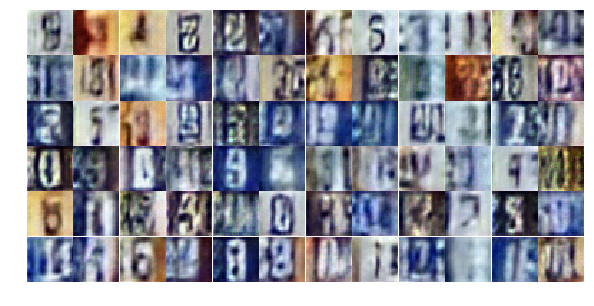

Epoch 6/25... Discriminator Loss: 0.8032... Generator Loss: 1.2673
Epoch 6/25... Discriminator Loss: 0.7390... Generator Loss: 2.4113
Epoch 6/25... Discriminator Loss: 1.5886... Generator Loss: 0.3216
Epoch 6/25... Discriminator Loss: 1.1321... Generator Loss: 2.6818
Epoch 6/25... Discriminator Loss: 0.6558... Generator Loss: 2.0929
Epoch 6/25... Discriminator Loss: 1.1230... Generator Loss: 0.5786
Epoch 6/25... Discriminator Loss: 0.8109... Generator Loss: 0.8179
Epoch 6/25... Discriminator Loss: 0.4946... Generator Loss: 1.3161
Epoch 6/25... Discriminator Loss: 0.6169... Generator Loss: 1.2191
Epoch 6/25... Discriminator Loss: 0.4844... Generator Loss: 1.5225


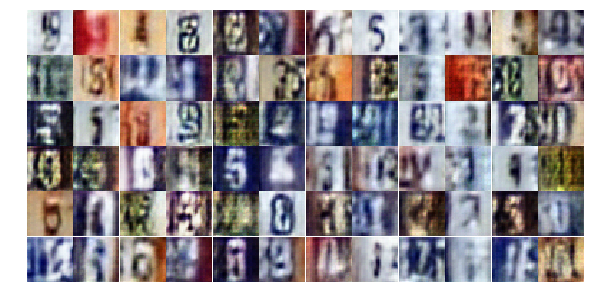

Epoch 6/25... Discriminator Loss: 0.5583... Generator Loss: 1.2049
Epoch 6/25... Discriminator Loss: 0.6151... Generator Loss: 1.3053
Epoch 6/25... Discriminator Loss: 1.6465... Generator Loss: 0.3074
Epoch 6/25... Discriminator Loss: 0.6001... Generator Loss: 1.1682
Epoch 6/25... Discriminator Loss: 0.6231... Generator Loss: 1.1112
Epoch 6/25... Discriminator Loss: 0.6873... Generator Loss: 1.0089
Epoch 6/25... Discriminator Loss: 0.6690... Generator Loss: 1.4036
Epoch 6/25... Discriminator Loss: 0.4636... Generator Loss: 1.6148
Epoch 6/25... Discriminator Loss: 1.0334... Generator Loss: 0.6107
Epoch 6/25... Discriminator Loss: 0.4180... Generator Loss: 1.4509


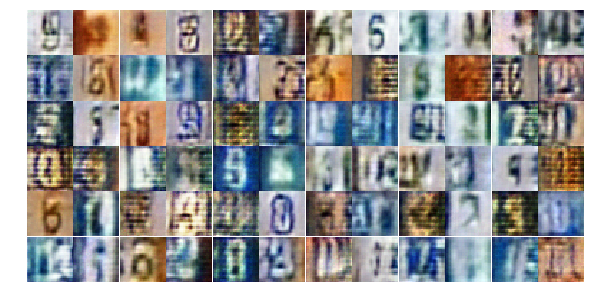

Epoch 6/25... Discriminator Loss: 0.4998... Generator Loss: 1.3579
Epoch 6/25... Discriminator Loss: 0.7037... Generator Loss: 1.1266
Epoch 6/25... Discriminator Loss: 0.6370... Generator Loss: 1.5314
Epoch 6/25... Discriminator Loss: 0.5595... Generator Loss: 1.8942
Epoch 6/25... Discriminator Loss: 0.7005... Generator Loss: 1.9806
Epoch 6/25... Discriminator Loss: 0.7279... Generator Loss: 0.8989
Epoch 6/25... Discriminator Loss: 0.8353... Generator Loss: 2.4276
Epoch 6/25... Discriminator Loss: 0.9942... Generator Loss: 0.6304
Epoch 6/25... Discriminator Loss: 0.6438... Generator Loss: 1.2663
Epoch 6/25... Discriminator Loss: 0.9166... Generator Loss: 0.6422


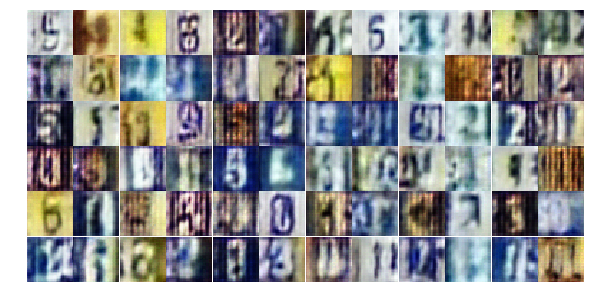

Epoch 6/25... Discriminator Loss: 0.9607... Generator Loss: 0.7174
Epoch 6/25... Discriminator Loss: 0.6318... Generator Loss: 1.0897
Epoch 6/25... Discriminator Loss: 0.7109... Generator Loss: 1.2501
Epoch 7/25... Discriminator Loss: 0.6797... Generator Loss: 2.0127
Epoch 7/25... Discriminator Loss: 0.9793... Generator Loss: 1.1614
Epoch 7/25... Discriminator Loss: 0.7820... Generator Loss: 0.8748
Epoch 7/25... Discriminator Loss: 0.4133... Generator Loss: 1.6507
Epoch 7/25... Discriminator Loss: 0.4257... Generator Loss: 2.3874
Epoch 7/25... Discriminator Loss: 0.4296... Generator Loss: 1.5619
Epoch 7/25... Discriminator Loss: 1.1805... Generator Loss: 0.5055


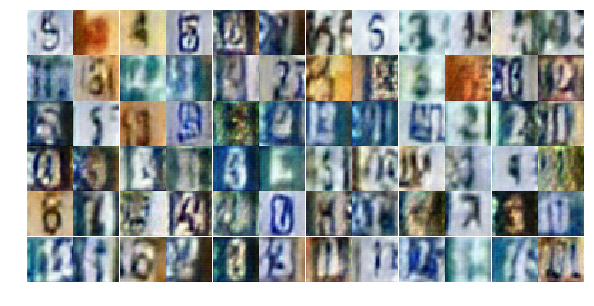

Epoch 7/25... Discriminator Loss: 0.7909... Generator Loss: 1.4137
Epoch 7/25... Discriminator Loss: 0.8138... Generator Loss: 0.9060
Epoch 7/25... Discriminator Loss: 0.8648... Generator Loss: 0.7869
Epoch 7/25... Discriminator Loss: 0.6385... Generator Loss: 1.4801
Epoch 7/25... Discriminator Loss: 0.5293... Generator Loss: 1.2589
Epoch 7/25... Discriminator Loss: 0.7493... Generator Loss: 0.8041
Epoch 7/25... Discriminator Loss: 0.8566... Generator Loss: 2.6273
Epoch 7/25... Discriminator Loss: 1.4956... Generator Loss: 3.4101
Epoch 7/25... Discriminator Loss: 2.3373... Generator Loss: 3.3618
Epoch 7/25... Discriminator Loss: 0.4672... Generator Loss: 2.1460


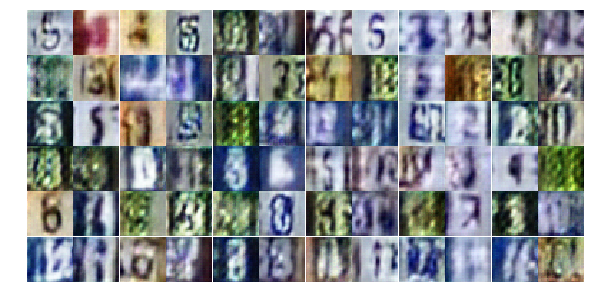

Epoch 7/25... Discriminator Loss: 0.7445... Generator Loss: 1.0762
Epoch 7/25... Discriminator Loss: 0.4281... Generator Loss: 1.7254
Epoch 7/25... Discriminator Loss: 1.0303... Generator Loss: 0.6425
Epoch 7/25... Discriminator Loss: 0.6093... Generator Loss: 1.8018
Epoch 7/25... Discriminator Loss: 0.7468... Generator Loss: 2.3318
Epoch 7/25... Discriminator Loss: 0.5696... Generator Loss: 1.2310
Epoch 7/25... Discriminator Loss: 0.6051... Generator Loss: 1.1237
Epoch 7/25... Discriminator Loss: 1.4627... Generator Loss: 0.3462
Epoch 7/25... Discriminator Loss: 0.4713... Generator Loss: 1.9780
Epoch 7/25... Discriminator Loss: 0.5537... Generator Loss: 2.2178


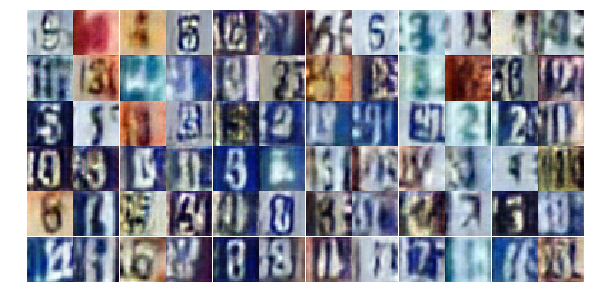

Epoch 7/25... Discriminator Loss: 0.8124... Generator Loss: 0.8400
Epoch 7/25... Discriminator Loss: 1.1458... Generator Loss: 0.5204
Epoch 7/25... Discriminator Loss: 0.5456... Generator Loss: 1.2349
Epoch 7/25... Discriminator Loss: 0.7516... Generator Loss: 0.9835
Epoch 7/25... Discriminator Loss: 0.6558... Generator Loss: 1.2444
Epoch 7/25... Discriminator Loss: 1.1425... Generator Loss: 0.5478
Epoch 7/25... Discriminator Loss: 0.8888... Generator Loss: 0.6935
Epoch 7/25... Discriminator Loss: 0.6877... Generator Loss: 1.0974
Epoch 7/25... Discriminator Loss: 1.0660... Generator Loss: 0.5716
Epoch 7/25... Discriminator Loss: 0.6948... Generator Loss: 2.6990


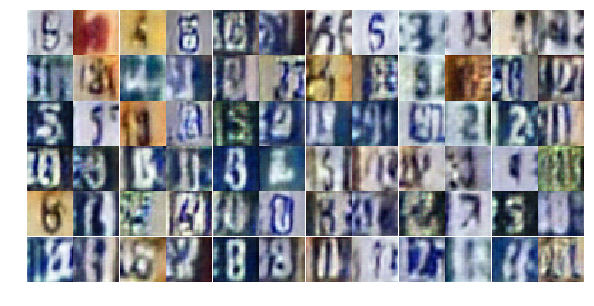

Epoch 7/25... Discriminator Loss: 1.2659... Generator Loss: 0.4580
Epoch 7/25... Discriminator Loss: 0.8803... Generator Loss: 1.2950
Epoch 7/25... Discriminator Loss: 0.5356... Generator Loss: 1.5784
Epoch 7/25... Discriminator Loss: 0.5210... Generator Loss: 1.6373
Epoch 7/25... Discriminator Loss: 0.8322... Generator Loss: 0.8991
Epoch 7/25... Discriminator Loss: 0.4406... Generator Loss: 1.4297
Epoch 7/25... Discriminator Loss: 0.4383... Generator Loss: 1.4193
Epoch 7/25... Discriminator Loss: 1.3972... Generator Loss: 0.4307
Epoch 7/25... Discriminator Loss: 0.5051... Generator Loss: 1.3280
Epoch 7/25... Discriminator Loss: 0.6682... Generator Loss: 1.7114


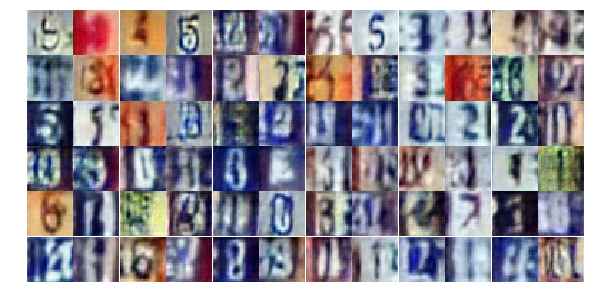

Epoch 7/25... Discriminator Loss: 0.4876... Generator Loss: 1.5908
Epoch 7/25... Discriminator Loss: 0.5288... Generator Loss: 1.5199
Epoch 7/25... Discriminator Loss: 0.7952... Generator Loss: 1.1075
Epoch 7/25... Discriminator Loss: 0.9790... Generator Loss: 0.6114
Epoch 7/25... Discriminator Loss: 0.6373... Generator Loss: 0.9978
Epoch 7/25... Discriminator Loss: 1.1779... Generator Loss: 0.6227
Epoch 7/25... Discriminator Loss: 1.0876... Generator Loss: 0.5821
Epoch 7/25... Discriminator Loss: 0.7689... Generator Loss: 1.0646
Epoch 7/25... Discriminator Loss: 0.6937... Generator Loss: 1.1942
Epoch 7/25... Discriminator Loss: 0.5260... Generator Loss: 1.2511


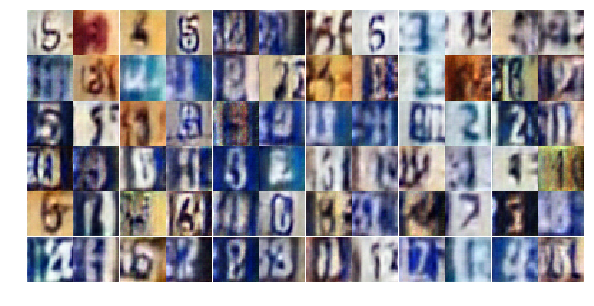

Epoch 7/25... Discriminator Loss: 0.6877... Generator Loss: 1.8463
Epoch 8/25... Discriminator Loss: 0.8120... Generator Loss: 1.1419
Epoch 8/25... Discriminator Loss: 0.9473... Generator Loss: 0.6699
Epoch 8/25... Discriminator Loss: 0.7172... Generator Loss: 1.0173
Epoch 8/25... Discriminator Loss: 0.8991... Generator Loss: 0.8197
Epoch 8/25... Discriminator Loss: 0.6439... Generator Loss: 1.3077
Epoch 8/25... Discriminator Loss: 0.5629... Generator Loss: 1.2517
Epoch 8/25... Discriminator Loss: 0.4639... Generator Loss: 1.6045
Epoch 8/25... Discriminator Loss: 1.1647... Generator Loss: 0.4780
Epoch 8/25... Discriminator Loss: 0.9371... Generator Loss: 0.7101


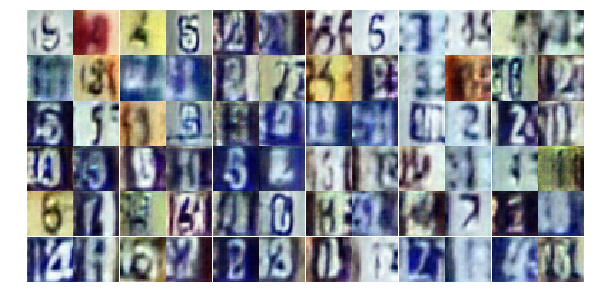

Epoch 8/25... Discriminator Loss: 0.5464... Generator Loss: 1.5382
Epoch 8/25... Discriminator Loss: 0.5867... Generator Loss: 1.3077
Epoch 8/25... Discriminator Loss: 0.7302... Generator Loss: 0.8959
Epoch 8/25... Discriminator Loss: 0.4136... Generator Loss: 2.0719
Epoch 8/25... Discriminator Loss: 1.6761... Generator Loss: 0.2663
Epoch 8/25... Discriminator Loss: 0.6403... Generator Loss: 2.6269
Epoch 8/25... Discriminator Loss: 0.8191... Generator Loss: 0.8576
Epoch 8/25... Discriminator Loss: 0.6164... Generator Loss: 1.3680
Epoch 8/25... Discriminator Loss: 0.4897... Generator Loss: 1.4061
Epoch 8/25... Discriminator Loss: 1.2482... Generator Loss: 0.4933


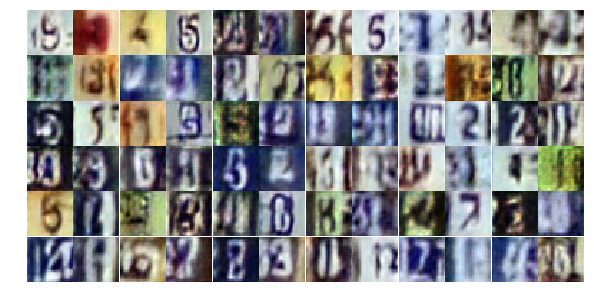

Epoch 8/25... Discriminator Loss: 0.3915... Generator Loss: 1.7870
Epoch 8/25... Discriminator Loss: 1.7326... Generator Loss: 0.2931
Epoch 8/25... Discriminator Loss: 0.5778... Generator Loss: 1.5086
Epoch 8/25... Discriminator Loss: 0.6900... Generator Loss: 1.5422
Epoch 8/25... Discriminator Loss: 0.3287... Generator Loss: 1.9545
Epoch 8/25... Discriminator Loss: 0.6399... Generator Loss: 1.0820
Epoch 8/25... Discriminator Loss: 0.3918... Generator Loss: 1.8412
Epoch 8/25... Discriminator Loss: 0.6675... Generator Loss: 0.9656
Epoch 8/25... Discriminator Loss: 0.9307... Generator Loss: 2.1777
Epoch 8/25... Discriminator Loss: 0.6777... Generator Loss: 1.0663


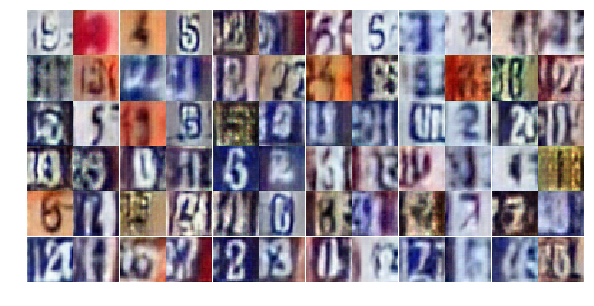

Epoch 8/25... Discriminator Loss: 0.6808... Generator Loss: 1.7893
Epoch 8/25... Discriminator Loss: 0.6169... Generator Loss: 1.2563
Epoch 8/25... Discriminator Loss: 0.7891... Generator Loss: 0.8261
Epoch 8/25... Discriminator Loss: 0.7230... Generator Loss: 0.9700
Epoch 8/25... Discriminator Loss: 0.9569... Generator Loss: 0.7258
Epoch 8/25... Discriminator Loss: 0.7922... Generator Loss: 0.8514
Epoch 8/25... Discriminator Loss: 0.6583... Generator Loss: 1.2099
Epoch 8/25... Discriminator Loss: 0.5751... Generator Loss: 1.2908
Epoch 8/25... Discriminator Loss: 0.6804... Generator Loss: 0.9576
Epoch 8/25... Discriminator Loss: 0.4852... Generator Loss: 1.3260


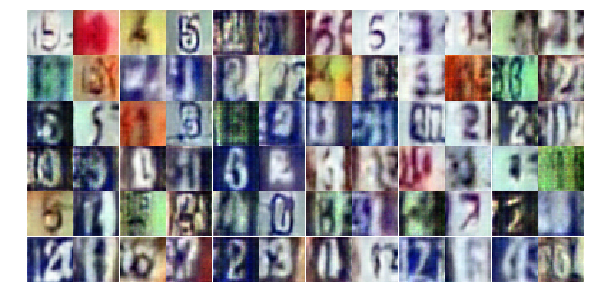

Epoch 8/25... Discriminator Loss: 0.4433... Generator Loss: 1.8263
Epoch 8/25... Discriminator Loss: 0.9763... Generator Loss: 0.6395
Epoch 8/25... Discriminator Loss: 0.8315... Generator Loss: 0.8068
Epoch 8/25... Discriminator Loss: 0.6062... Generator Loss: 1.0391
Epoch 8/25... Discriminator Loss: 1.2468... Generator Loss: 3.0441
Epoch 8/25... Discriminator Loss: 0.5651... Generator Loss: 1.4727
Epoch 8/25... Discriminator Loss: 0.5434... Generator Loss: 1.5999
Epoch 8/25... Discriminator Loss: 0.4302... Generator Loss: 1.5265
Epoch 8/25... Discriminator Loss: 0.4490... Generator Loss: 1.8175
Epoch 8/25... Discriminator Loss: 0.7684... Generator Loss: 0.8574


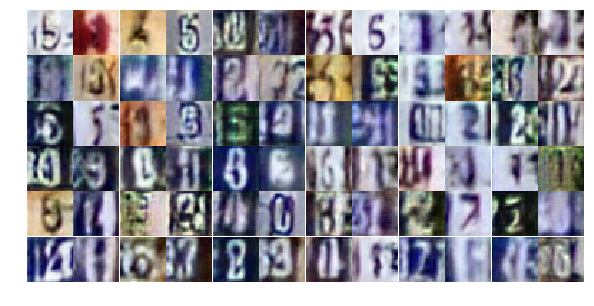

Epoch 8/25... Discriminator Loss: 0.6478... Generator Loss: 2.1224
Epoch 8/25... Discriminator Loss: 0.5847... Generator Loss: 1.2414
Epoch 8/25... Discriminator Loss: 0.7539... Generator Loss: 0.8603
Epoch 8/25... Discriminator Loss: 0.9183... Generator Loss: 0.6815
Epoch 8/25... Discriminator Loss: 0.2823... Generator Loss: 2.4333
Epoch 8/25... Discriminator Loss: 1.7515... Generator Loss: 0.2648
Epoch 8/25... Discriminator Loss: 1.6358... Generator Loss: 0.3036
Epoch 8/25... Discriminator Loss: 0.7332... Generator Loss: 1.6942
Epoch 9/25... Discriminator Loss: 1.5494... Generator Loss: 0.3295
Epoch 9/25... Discriminator Loss: 0.9633... Generator Loss: 0.6527


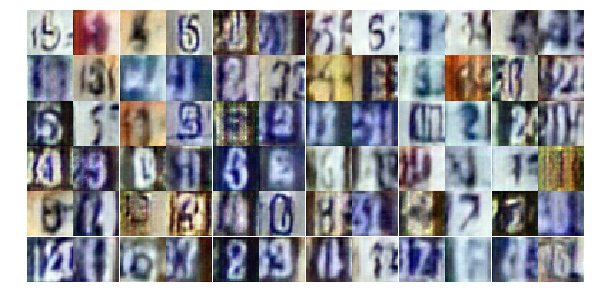

Epoch 9/25... Discriminator Loss: 0.7766... Generator Loss: 0.8515
Epoch 9/25... Discriminator Loss: 0.7308... Generator Loss: 1.0129
Epoch 9/25... Discriminator Loss: 0.7271... Generator Loss: 0.9291
Epoch 9/25... Discriminator Loss: 0.3305... Generator Loss: 1.9462
Epoch 9/25... Discriminator Loss: 1.5283... Generator Loss: 0.3658
Epoch 9/25... Discriminator Loss: 0.5818... Generator Loss: 2.3208
Epoch 9/25... Discriminator Loss: 0.6951... Generator Loss: 1.0320
Epoch 9/25... Discriminator Loss: 0.5875... Generator Loss: 1.1822
Epoch 9/25... Discriminator Loss: 0.6016... Generator Loss: 1.1267
Epoch 9/25... Discriminator Loss: 0.6356... Generator Loss: 1.1742


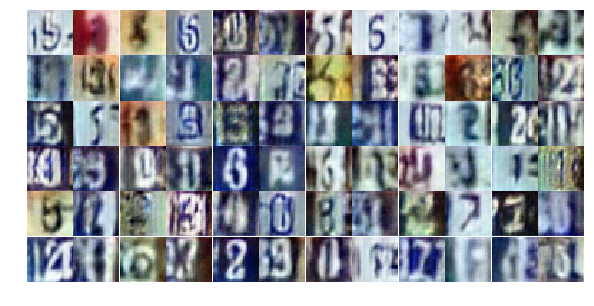

Epoch 9/25... Discriminator Loss: 0.7595... Generator Loss: 1.0123
Epoch 9/25... Discriminator Loss: 1.3299... Generator Loss: 0.4284
Epoch 9/25... Discriminator Loss: 0.7646... Generator Loss: 0.8908
Epoch 9/25... Discriminator Loss: 0.7298... Generator Loss: 0.9429
Epoch 9/25... Discriminator Loss: 0.5312... Generator Loss: 1.7053
Epoch 9/25... Discriminator Loss: 0.7158... Generator Loss: 1.1833
Epoch 9/25... Discriminator Loss: 1.0732... Generator Loss: 0.5830
Epoch 9/25... Discriminator Loss: 0.6831... Generator Loss: 0.9138
Epoch 9/25... Discriminator Loss: 1.5370... Generator Loss: 0.3427
Epoch 9/25... Discriminator Loss: 1.1378... Generator Loss: 0.5419


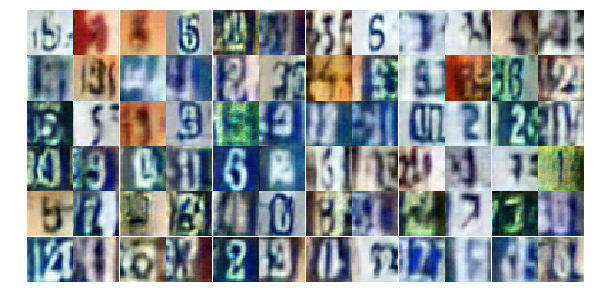

Epoch 9/25... Discriminator Loss: 0.7716... Generator Loss: 0.9465
Epoch 9/25... Discriminator Loss: 0.4877... Generator Loss: 1.7456
Epoch 9/25... Discriminator Loss: 0.7519... Generator Loss: 1.1571
Epoch 9/25... Discriminator Loss: 0.7989... Generator Loss: 2.4760
Epoch 9/25... Discriminator Loss: 0.6083... Generator Loss: 1.8657
Epoch 9/25... Discriminator Loss: 0.5167... Generator Loss: 1.6640
Epoch 9/25... Discriminator Loss: 1.0017... Generator Loss: 0.6641
Epoch 9/25... Discriminator Loss: 0.5414... Generator Loss: 1.9627
Epoch 9/25... Discriminator Loss: 0.4990... Generator Loss: 1.3144
Epoch 9/25... Discriminator Loss: 0.5041... Generator Loss: 1.2244


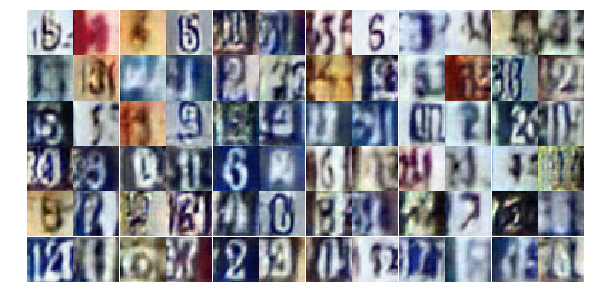

Epoch 9/25... Discriminator Loss: 0.5893... Generator Loss: 1.2053
Epoch 9/25... Discriminator Loss: 0.6359... Generator Loss: 1.0078
Epoch 9/25... Discriminator Loss: 0.7803... Generator Loss: 0.8632
Epoch 9/25... Discriminator Loss: 0.6038... Generator Loss: 1.2283
Epoch 9/25... Discriminator Loss: 0.5473... Generator Loss: 1.4378
Epoch 9/25... Discriminator Loss: 0.8399... Generator Loss: 2.2704
Epoch 9/25... Discriminator Loss: 0.8386... Generator Loss: 1.9507
Epoch 9/25... Discriminator Loss: 0.4128... Generator Loss: 1.6688
Epoch 9/25... Discriminator Loss: 1.2609... Generator Loss: 0.4877
Epoch 9/25... Discriminator Loss: 0.6362... Generator Loss: 1.0596


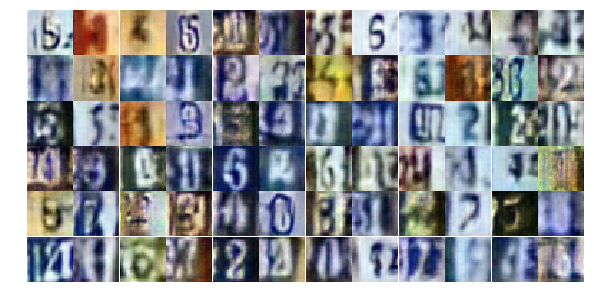

Epoch 9/25... Discriminator Loss: 0.7282... Generator Loss: 2.3878
Epoch 9/25... Discriminator Loss: 0.5209... Generator Loss: 1.3972
Epoch 9/25... Discriminator Loss: 0.5344... Generator Loss: 1.8211
Epoch 9/25... Discriminator Loss: 0.6361... Generator Loss: 1.3388
Epoch 9/25... Discriminator Loss: 0.3968... Generator Loss: 1.7350
Epoch 9/25... Discriminator Loss: 0.9572... Generator Loss: 2.6533
Epoch 9/25... Discriminator Loss: 0.7707... Generator Loss: 1.0806
Epoch 9/25... Discriminator Loss: 0.6418... Generator Loss: 1.0712
Epoch 9/25... Discriminator Loss: 0.5770... Generator Loss: 1.5402
Epoch 9/25... Discriminator Loss: 0.8071... Generator Loss: 2.3331


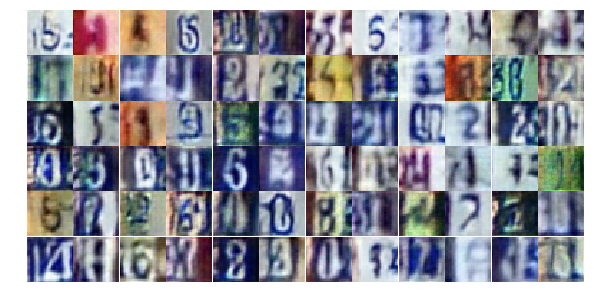

Epoch 9/25... Discriminator Loss: 0.9257... Generator Loss: 0.7165
Epoch 9/25... Discriminator Loss: 1.6461... Generator Loss: 3.2100
Epoch 9/25... Discriminator Loss: 0.5981... Generator Loss: 1.5483
Epoch 9/25... Discriminator Loss: 1.2881... Generator Loss: 0.4555
Epoch 9/25... Discriminator Loss: 0.8619... Generator Loss: 0.7736
Epoch 10/25... Discriminator Loss: 0.6053... Generator Loss: 1.3426
Epoch 10/25... Discriminator Loss: 0.5037... Generator Loss: 1.5101
Epoch 10/25... Discriminator Loss: 0.5734... Generator Loss: 1.1529
Epoch 10/25... Discriminator Loss: 0.9346... Generator Loss: 0.6748
Epoch 10/25... Discriminator Loss: 1.2216... Generator Loss: 0.4584


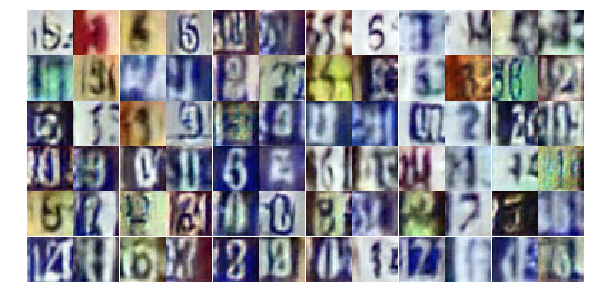

Epoch 10/25... Discriminator Loss: 1.0059... Generator Loss: 0.6330
Epoch 10/25... Discriminator Loss: 0.5150... Generator Loss: 1.8209
Epoch 10/25... Discriminator Loss: 0.6615... Generator Loss: 1.1399
Epoch 10/25... Discriminator Loss: 0.6422... Generator Loss: 1.0337
Epoch 10/25... Discriminator Loss: 0.5049... Generator Loss: 2.3088
Epoch 10/25... Discriminator Loss: 0.6537... Generator Loss: 1.3936
Epoch 10/25... Discriminator Loss: 0.5956... Generator Loss: 1.1141
Epoch 10/25... Discriminator Loss: 0.7352... Generator Loss: 0.9121
Epoch 10/25... Discriminator Loss: 0.8978... Generator Loss: 0.8058
Epoch 10/25... Discriminator Loss: 1.6814... Generator Loss: 0.3216


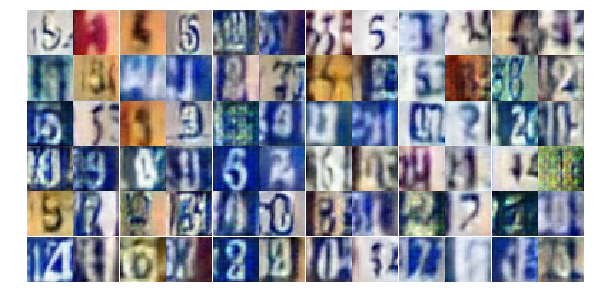

Epoch 10/25... Discriminator Loss: 0.9134... Generator Loss: 0.9309
Epoch 10/25... Discriminator Loss: 0.8381... Generator Loss: 0.8965
Epoch 10/25... Discriminator Loss: 0.6403... Generator Loss: 1.0896
Epoch 10/25... Discriminator Loss: 1.0814... Generator Loss: 0.5929
Epoch 10/25... Discriminator Loss: 0.6909... Generator Loss: 1.1525
Epoch 10/25... Discriminator Loss: 0.5850... Generator Loss: 1.1876
Epoch 10/25... Discriminator Loss: 0.8499... Generator Loss: 0.7541
Epoch 10/25... Discriminator Loss: 0.5493... Generator Loss: 1.2851
Epoch 10/25... Discriminator Loss: 0.6164... Generator Loss: 1.1115
Epoch 10/25... Discriminator Loss: 0.3989... Generator Loss: 2.0644


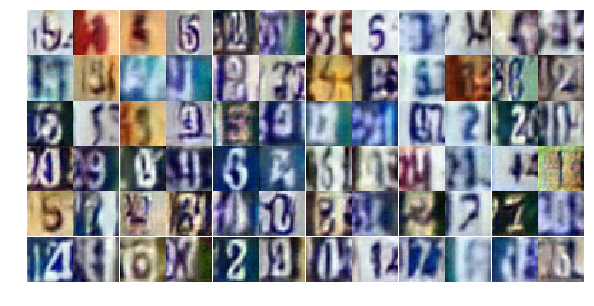

Epoch 10/25... Discriminator Loss: 0.9316... Generator Loss: 0.6440
Epoch 10/25... Discriminator Loss: 0.6163... Generator Loss: 1.4939
Epoch 10/25... Discriminator Loss: 0.3663... Generator Loss: 1.7467
Epoch 10/25... Discriminator Loss: 0.9492... Generator Loss: 2.7344
Epoch 10/25... Discriminator Loss: 1.4642... Generator Loss: 0.3721
Epoch 10/25... Discriminator Loss: 0.6377... Generator Loss: 1.1097
Epoch 10/25... Discriminator Loss: 0.3755... Generator Loss: 1.7748
Epoch 10/25... Discriminator Loss: 0.7626... Generator Loss: 1.1545
Epoch 10/25... Discriminator Loss: 0.5076... Generator Loss: 1.3045
Epoch 10/25... Discriminator Loss: 0.6796... Generator Loss: 0.9780


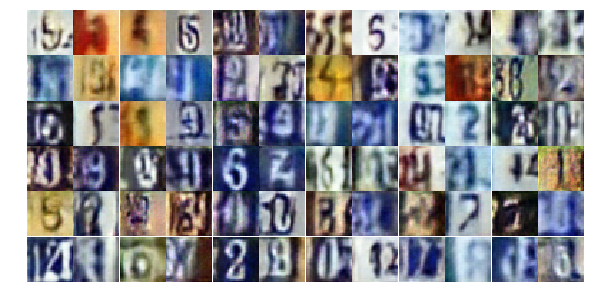

Epoch 10/25... Discriminator Loss: 0.6386... Generator Loss: 2.5455
Epoch 10/25... Discriminator Loss: 0.5580... Generator Loss: 1.4798
Epoch 10/25... Discriminator Loss: 0.5009... Generator Loss: 1.4374
Epoch 10/25... Discriminator Loss: 0.5880... Generator Loss: 1.6436
Epoch 10/25... Discriminator Loss: 0.8232... Generator Loss: 2.0099
Epoch 10/25... Discriminator Loss: 0.8836... Generator Loss: 0.6853
Epoch 10/25... Discriminator Loss: 0.7929... Generator Loss: 0.8950
Epoch 10/25... Discriminator Loss: 0.7907... Generator Loss: 0.8046
Epoch 10/25... Discriminator Loss: 0.6613... Generator Loss: 0.9755
Epoch 10/25... Discriminator Loss: 0.4983... Generator Loss: 1.4756


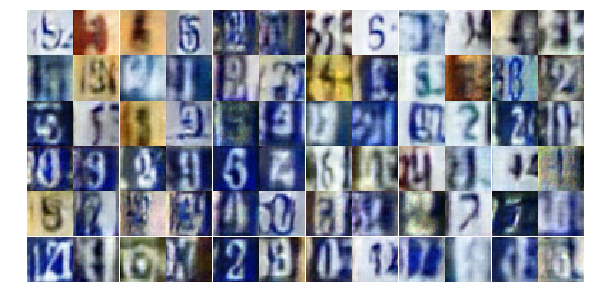

Epoch 10/25... Discriminator Loss: 0.7507... Generator Loss: 0.9374
Epoch 10/25... Discriminator Loss: 0.7324... Generator Loss: 1.0769
Epoch 10/25... Discriminator Loss: 0.8126... Generator Loss: 0.8598
Epoch 10/25... Discriminator Loss: 0.6748... Generator Loss: 1.1192
Epoch 10/25... Discriminator Loss: 0.4240... Generator Loss: 2.0998
Epoch 10/25... Discriminator Loss: 0.8490... Generator Loss: 0.7412
Epoch 10/25... Discriminator Loss: 0.4533... Generator Loss: 1.4704
Epoch 10/25... Discriminator Loss: 0.3876... Generator Loss: 2.0188
Epoch 10/25... Discriminator Loss: 0.7732... Generator Loss: 2.6962
Epoch 10/25... Discriminator Loss: 0.7166... Generator Loss: 1.0620


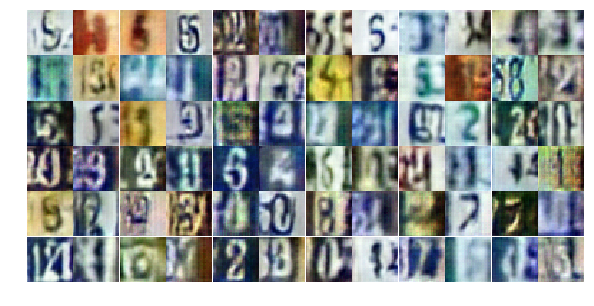

Epoch 10/25... Discriminator Loss: 0.8257... Generator Loss: 0.8897
Epoch 10/25... Discriminator Loss: 0.7725... Generator Loss: 0.8003
Epoch 10/25... Discriminator Loss: 0.4025... Generator Loss: 1.5017
Epoch 11/25... Discriminator Loss: 0.8457... Generator Loss: 0.8235
Epoch 11/25... Discriminator Loss: 0.7293... Generator Loss: 0.9549
Epoch 11/25... Discriminator Loss: 1.1798... Generator Loss: 0.5480
Epoch 11/25... Discriminator Loss: 0.5620... Generator Loss: 1.4355
Epoch 11/25... Discriminator Loss: 0.5442... Generator Loss: 1.2286
Epoch 11/25... Discriminator Loss: 1.4565... Generator Loss: 0.3688
Epoch 11/25... Discriminator Loss: 0.5563... Generator Loss: 1.3485


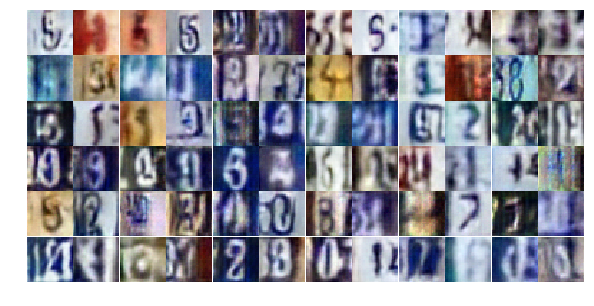

Epoch 11/25... Discriminator Loss: 0.3502... Generator Loss: 1.9684
Epoch 11/25... Discriminator Loss: 0.6407... Generator Loss: 1.5549
Epoch 11/25... Discriminator Loss: 0.4435... Generator Loss: 1.6672
Epoch 11/25... Discriminator Loss: 0.7189... Generator Loss: 0.9247
Epoch 11/25... Discriminator Loss: 0.9251... Generator Loss: 0.7244
Epoch 11/25... Discriminator Loss: 0.4756... Generator Loss: 1.6527
Epoch 11/25... Discriminator Loss: 0.5068... Generator Loss: 1.8828
Epoch 11/25... Discriminator Loss: 0.3549... Generator Loss: 2.0018
Epoch 11/25... Discriminator Loss: 0.4864... Generator Loss: 1.4653
Epoch 11/25... Discriminator Loss: 1.0701... Generator Loss: 0.6267


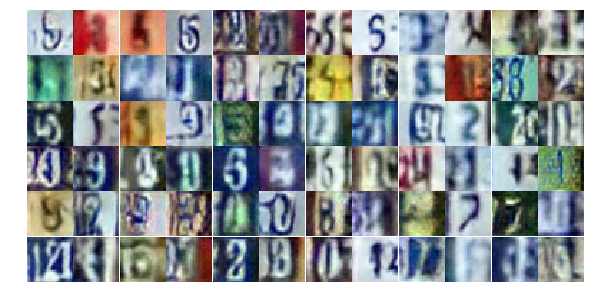

Epoch 11/25... Discriminator Loss: 0.9640... Generator Loss: 0.6963
Epoch 11/25... Discriminator Loss: 0.4158... Generator Loss: 1.7123
Epoch 11/25... Discriminator Loss: 1.2057... Generator Loss: 0.4703
Epoch 11/25... Discriminator Loss: 0.6155... Generator Loss: 1.2744
Epoch 11/25... Discriminator Loss: 0.9977... Generator Loss: 0.6092
Epoch 11/25... Discriminator Loss: 0.4714... Generator Loss: 1.4852
Epoch 11/25... Discriminator Loss: 0.5576... Generator Loss: 1.2661
Epoch 11/25... Discriminator Loss: 0.8250... Generator Loss: 0.9420
Epoch 11/25... Discriminator Loss: 0.4834... Generator Loss: 1.4688
Epoch 11/25... Discriminator Loss: 0.6408... Generator Loss: 1.0627


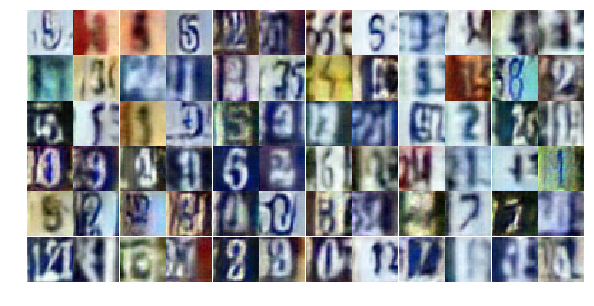

Epoch 11/25... Discriminator Loss: 1.0880... Generator Loss: 0.5901
Epoch 11/25... Discriminator Loss: 0.6520... Generator Loss: 1.1360
Epoch 11/25... Discriminator Loss: 0.7118... Generator Loss: 1.0806
Epoch 11/25... Discriminator Loss: 0.5141... Generator Loss: 1.3282
Epoch 11/25... Discriminator Loss: 0.8413... Generator Loss: 0.8469
Epoch 11/25... Discriminator Loss: 1.2724... Generator Loss: 0.4273
Epoch 11/25... Discriminator Loss: 1.5398... Generator Loss: 0.3551
Epoch 11/25... Discriminator Loss: 0.8024... Generator Loss: 0.8433
Epoch 11/25... Discriminator Loss: 0.6349... Generator Loss: 1.1643
Epoch 11/25... Discriminator Loss: 1.1999... Generator Loss: 0.5038


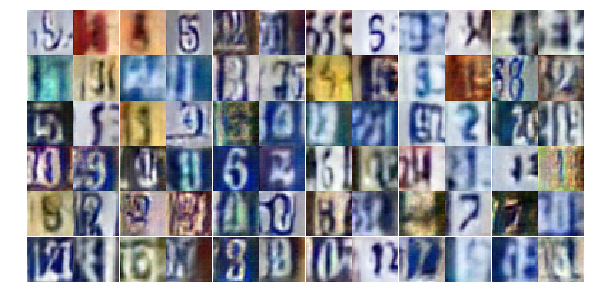

Epoch 11/25... Discriminator Loss: 0.6018... Generator Loss: 1.6519
Epoch 11/25... Discriminator Loss: 0.4704... Generator Loss: 1.5686
Epoch 11/25... Discriminator Loss: 0.9654... Generator Loss: 0.7682
Epoch 11/25... Discriminator Loss: 0.7421... Generator Loss: 1.1054
Epoch 11/25... Discriminator Loss: 0.7802... Generator Loss: 0.8209
Epoch 11/25... Discriminator Loss: 0.7993... Generator Loss: 0.8416
Epoch 11/25... Discriminator Loss: 0.3579... Generator Loss: 1.7082
Epoch 11/25... Discriminator Loss: 0.5995... Generator Loss: 1.1588
Epoch 11/25... Discriminator Loss: 1.0562... Generator Loss: 0.6039
Epoch 11/25... Discriminator Loss: 0.4198... Generator Loss: 1.5434


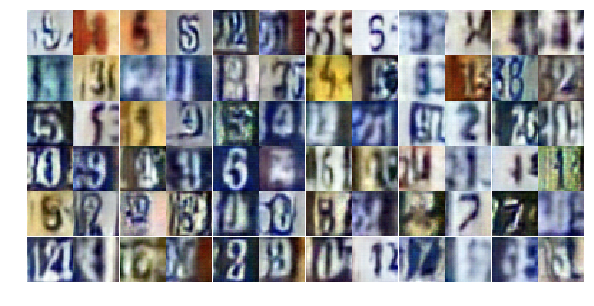

Epoch 11/25... Discriminator Loss: 0.5114... Generator Loss: 1.3581
Epoch 11/25... Discriminator Loss: 0.4201... Generator Loss: 2.0548
Epoch 11/25... Discriminator Loss: 0.6371... Generator Loss: 1.8997
Epoch 11/25... Discriminator Loss: 0.6573... Generator Loss: 1.3609
Epoch 11/25... Discriminator Loss: 1.4320... Generator Loss: 0.4356
Epoch 11/25... Discriminator Loss: 1.6062... Generator Loss: 0.4089
Epoch 11/25... Discriminator Loss: 0.7088... Generator Loss: 1.2439
Epoch 11/25... Discriminator Loss: 0.5881... Generator Loss: 1.3639
Epoch 11/25... Discriminator Loss: 0.9233... Generator Loss: 0.7548
Epoch 11/25... Discriminator Loss: 0.9309... Generator Loss: 0.7616


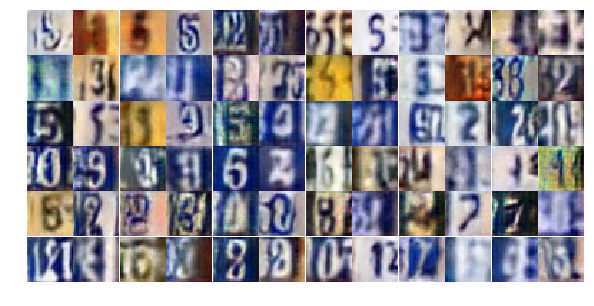

Epoch 12/25... Discriminator Loss: 0.6676... Generator Loss: 1.8109
Epoch 12/25... Discriminator Loss: 0.6602... Generator Loss: 1.0734
Epoch 12/25... Discriminator Loss: 0.7345... Generator Loss: 1.1847
Epoch 12/25... Discriminator Loss: 0.4256... Generator Loss: 1.8046
Epoch 12/25... Discriminator Loss: 0.5196... Generator Loss: 1.1934
Epoch 12/25... Discriminator Loss: 0.8257... Generator Loss: 0.7701
Epoch 12/25... Discriminator Loss: 0.5701... Generator Loss: 1.3626
Epoch 12/25... Discriminator Loss: 0.4452... Generator Loss: 1.6724
Epoch 12/25... Discriminator Loss: 0.7339... Generator Loss: 0.9789
Epoch 12/25... Discriminator Loss: 1.2387... Generator Loss: 0.5448


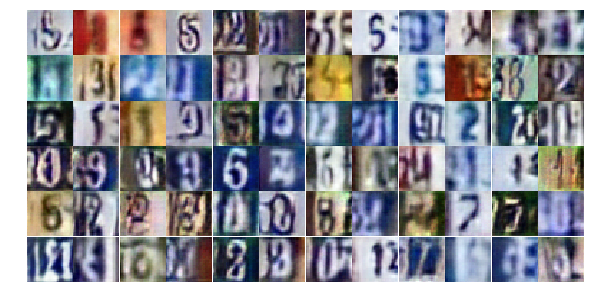

Epoch 12/25... Discriminator Loss: 0.4254... Generator Loss: 1.4184
Epoch 12/25... Discriminator Loss: 0.9063... Generator Loss: 0.7293
Epoch 12/25... Discriminator Loss: 0.5221... Generator Loss: 1.7302
Epoch 12/25... Discriminator Loss: 0.9894... Generator Loss: 0.6528
Epoch 12/25... Discriminator Loss: 0.7373... Generator Loss: 2.7753
Epoch 12/25... Discriminator Loss: 1.3064... Generator Loss: 0.5336
Epoch 12/25... Discriminator Loss: 1.5389... Generator Loss: 0.3340
Epoch 12/25... Discriminator Loss: 0.4837... Generator Loss: 1.7377
Epoch 12/25... Discriminator Loss: 0.5128... Generator Loss: 1.3207
Epoch 12/25... Discriminator Loss: 0.9406... Generator Loss: 0.6890


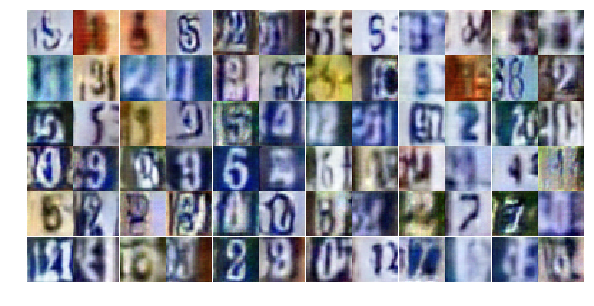

Epoch 12/25... Discriminator Loss: 0.3932... Generator Loss: 2.5479
Epoch 12/25... Discriminator Loss: 0.3950... Generator Loss: 1.8862
Epoch 12/25... Discriminator Loss: 0.5053... Generator Loss: 1.4146
Epoch 12/25... Discriminator Loss: 0.4464... Generator Loss: 1.5321
Epoch 12/25... Discriminator Loss: 0.4821... Generator Loss: 1.3973
Epoch 12/25... Discriminator Loss: 0.3851... Generator Loss: 1.8929
Epoch 12/25... Discriminator Loss: 0.6175... Generator Loss: 1.1676
Epoch 12/25... Discriminator Loss: 0.3628... Generator Loss: 1.8473
Epoch 12/25... Discriminator Loss: 0.7079... Generator Loss: 0.9391
Epoch 12/25... Discriminator Loss: 0.6798... Generator Loss: 1.0810


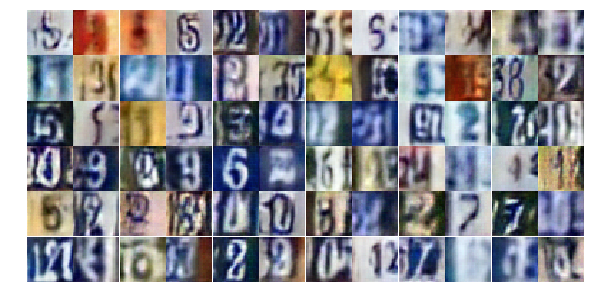

Epoch 12/25... Discriminator Loss: 0.5903... Generator Loss: 1.0639
Epoch 12/25... Discriminator Loss: 1.0051... Generator Loss: 0.6901
Epoch 12/25... Discriminator Loss: 0.9247... Generator Loss: 0.7384
Epoch 12/25... Discriminator Loss: 1.6088... Generator Loss: 0.3276
Epoch 12/25... Discriminator Loss: 1.1673... Generator Loss: 3.3398
Epoch 12/25... Discriminator Loss: 1.4275... Generator Loss: 0.4815
Epoch 12/25... Discriminator Loss: 0.8290... Generator Loss: 0.8072
Epoch 12/25... Discriminator Loss: 0.9778... Generator Loss: 1.2364
Epoch 12/25... Discriminator Loss: 0.6245... Generator Loss: 1.3816
Epoch 12/25... Discriminator Loss: 0.3871... Generator Loss: 1.5844


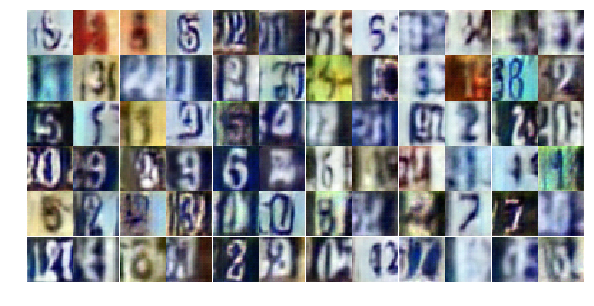

Epoch 12/25... Discriminator Loss: 0.5746... Generator Loss: 1.2888
Epoch 12/25... Discriminator Loss: 0.4419... Generator Loss: 1.4714
Epoch 12/25... Discriminator Loss: 0.4139... Generator Loss: 1.5038
Epoch 12/25... Discriminator Loss: 0.6330... Generator Loss: 1.0752
Epoch 12/25... Discriminator Loss: 0.7835... Generator Loss: 1.0521
Epoch 12/25... Discriminator Loss: 0.9393... Generator Loss: 1.7478
Epoch 12/25... Discriminator Loss: 0.6267... Generator Loss: 1.1270
Epoch 12/25... Discriminator Loss: 1.1561... Generator Loss: 0.7230
Epoch 12/25... Discriminator Loss: 0.5342... Generator Loss: 1.4606
Epoch 12/25... Discriminator Loss: 1.2177... Generator Loss: 0.4495


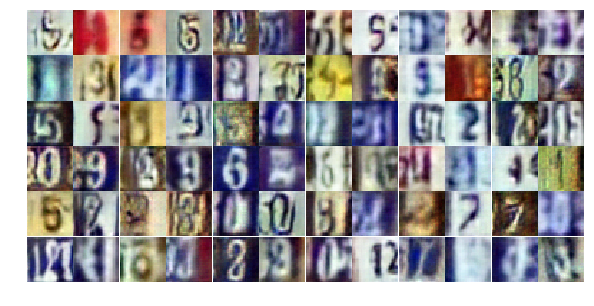

Epoch 12/25... Discriminator Loss: 0.9154... Generator Loss: 0.7682
Epoch 12/25... Discriminator Loss: 0.5152... Generator Loss: 1.4255
Epoch 12/25... Discriminator Loss: 0.8073... Generator Loss: 0.8652
Epoch 12/25... Discriminator Loss: 1.3216... Generator Loss: 0.5050
Epoch 12/25... Discriminator Loss: 0.5788... Generator Loss: 1.2826
Epoch 12/25... Discriminator Loss: 0.8115... Generator Loss: 1.0325
Epoch 12/25... Discriminator Loss: 0.7143... Generator Loss: 0.9299
Epoch 13/25... Discriminator Loss: 0.5605... Generator Loss: 1.2093
Epoch 13/25... Discriminator Loss: 0.3796... Generator Loss: 1.9121
Epoch 13/25... Discriminator Loss: 0.8448... Generator Loss: 0.8069


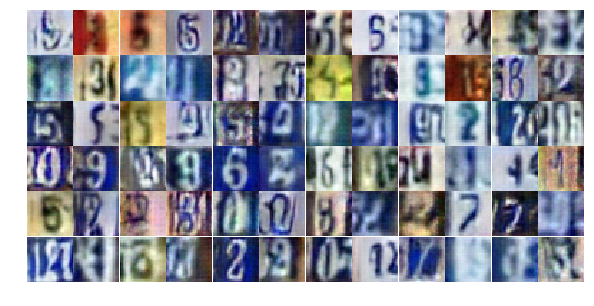

Epoch 13/25... Discriminator Loss: 0.5809... Generator Loss: 1.1142
Epoch 13/25... Discriminator Loss: 0.5235... Generator Loss: 1.8521
Epoch 13/25... Discriminator Loss: 1.3314... Generator Loss: 0.4741
Epoch 13/25... Discriminator Loss: 0.7816... Generator Loss: 0.9087
Epoch 13/25... Discriminator Loss: 0.6920... Generator Loss: 0.9630
Epoch 13/25... Discriminator Loss: 0.6880... Generator Loss: 1.7771
Epoch 13/25... Discriminator Loss: 0.3863... Generator Loss: 1.6495
Epoch 13/25... Discriminator Loss: 0.7074... Generator Loss: 0.9203
Epoch 13/25... Discriminator Loss: 0.4323... Generator Loss: 1.3352
Epoch 13/25... Discriminator Loss: 0.7574... Generator Loss: 2.1850


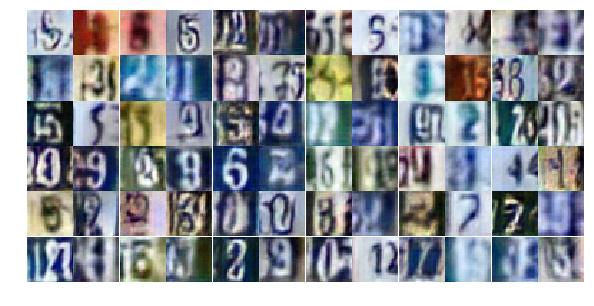

Epoch 13/25... Discriminator Loss: 0.8775... Generator Loss: 2.2764
Epoch 13/25... Discriminator Loss: 0.4678... Generator Loss: 1.6378
Epoch 13/25... Discriminator Loss: 0.8623... Generator Loss: 0.8066
Epoch 13/25... Discriminator Loss: 0.7228... Generator Loss: 1.4785
Epoch 13/25... Discriminator Loss: 0.5019... Generator Loss: 1.2281
Epoch 13/25... Discriminator Loss: 0.5847... Generator Loss: 1.4356
Epoch 13/25... Discriminator Loss: 0.6244... Generator Loss: 1.1808
Epoch 13/25... Discriminator Loss: 1.0603... Generator Loss: 0.5789
Epoch 13/25... Discriminator Loss: 0.6048... Generator Loss: 1.1844
Epoch 13/25... Discriminator Loss: 1.9558... Generator Loss: 0.2405


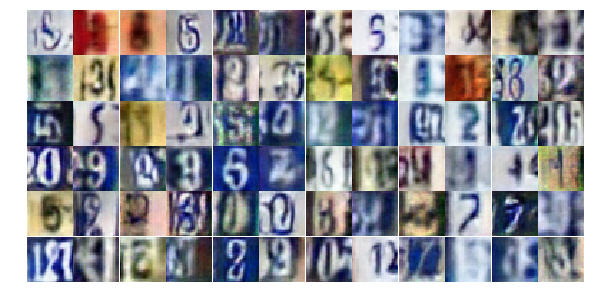

Epoch 13/25... Discriminator Loss: 0.8420... Generator Loss: 0.8549
Epoch 13/25... Discriminator Loss: 0.5448... Generator Loss: 1.2232
Epoch 13/25... Discriminator Loss: 0.7767... Generator Loss: 0.9836
Epoch 13/25... Discriminator Loss: 0.7644... Generator Loss: 0.8656
Epoch 13/25... Discriminator Loss: 0.6579... Generator Loss: 0.9970
Epoch 13/25... Discriminator Loss: 0.7800... Generator Loss: 0.8540
Epoch 13/25... Discriminator Loss: 0.6385... Generator Loss: 1.4491
Epoch 13/25... Discriminator Loss: 0.5178... Generator Loss: 1.2939
Epoch 13/25... Discriminator Loss: 0.5715... Generator Loss: 1.2180
Epoch 13/25... Discriminator Loss: 0.5179... Generator Loss: 1.4091


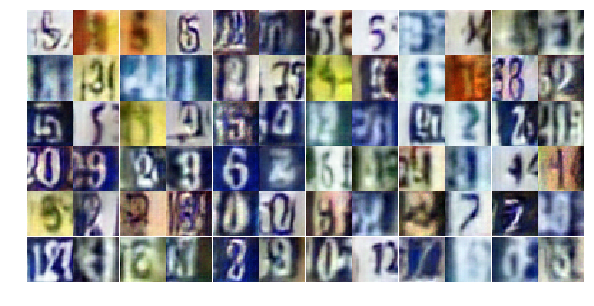

Epoch 13/25... Discriminator Loss: 1.1422... Generator Loss: 0.5139
Epoch 13/25... Discriminator Loss: 1.1723... Generator Loss: 0.5497
Epoch 13/25... Discriminator Loss: 0.7679... Generator Loss: 0.9552
Epoch 13/25... Discriminator Loss: 1.2773... Generator Loss: 0.4588
Epoch 13/25... Discriminator Loss: 0.5663... Generator Loss: 1.2425
Epoch 13/25... Discriminator Loss: 0.5719... Generator Loss: 1.3357
Epoch 13/25... Discriminator Loss: 0.3868... Generator Loss: 2.1295
Epoch 13/25... Discriminator Loss: 0.9404... Generator Loss: 0.7594
Epoch 13/25... Discriminator Loss: 0.5649... Generator Loss: 1.4871
Epoch 13/25... Discriminator Loss: 0.6453... Generator Loss: 1.0936


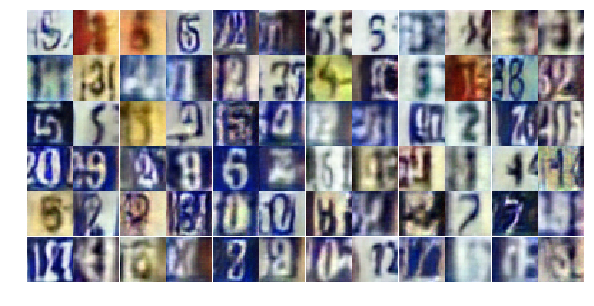

Epoch 13/25... Discriminator Loss: 0.5358... Generator Loss: 1.2816
Epoch 13/25... Discriminator Loss: 1.0856... Generator Loss: 0.6202
Epoch 13/25... Discriminator Loss: 0.7483... Generator Loss: 2.2014
Epoch 13/25... Discriminator Loss: 1.4408... Generator Loss: 0.3832
Epoch 13/25... Discriminator Loss: 0.8097... Generator Loss: 1.0028
Epoch 13/25... Discriminator Loss: 0.8171... Generator Loss: 1.4539
Epoch 13/25... Discriminator Loss: 0.7718... Generator Loss: 0.9665
Epoch 13/25... Discriminator Loss: 0.6486... Generator Loss: 1.1225
Epoch 13/25... Discriminator Loss: 0.6667... Generator Loss: 0.9333
Epoch 13/25... Discriminator Loss: 1.0060... Generator Loss: 0.6020


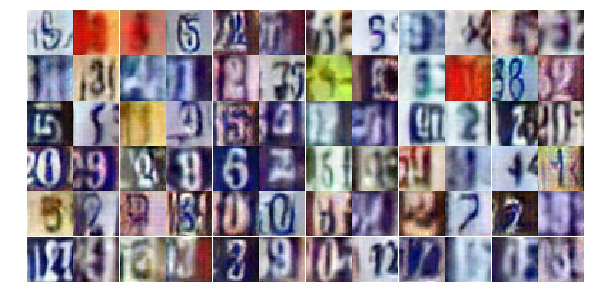

Epoch 13/25... Discriminator Loss: 0.3691... Generator Loss: 1.9655
Epoch 13/25... Discriminator Loss: 1.3407... Generator Loss: 0.4151
Epoch 13/25... Discriminator Loss: 0.7194... Generator Loss: 1.0277
Epoch 13/25... Discriminator Loss: 0.7274... Generator Loss: 0.9126
Epoch 14/25... Discriminator Loss: 0.8327... Generator Loss: 0.8014
Epoch 14/25... Discriminator Loss: 0.7020... Generator Loss: 1.0264
Epoch 14/25... Discriminator Loss: 0.6697... Generator Loss: 1.1998
Epoch 14/25... Discriminator Loss: 0.5451... Generator Loss: 2.0036
Epoch 14/25... Discriminator Loss: 0.5198... Generator Loss: 1.4535
Epoch 14/25... Discriminator Loss: 0.5733... Generator Loss: 1.1525


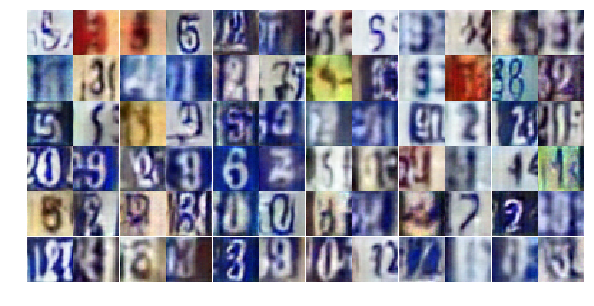

Epoch 14/25... Discriminator Loss: 0.9218... Generator Loss: 2.4635
Epoch 14/25... Discriminator Loss: 1.1697... Generator Loss: 0.5012
Epoch 14/25... Discriminator Loss: 0.5314... Generator Loss: 1.3455
Epoch 14/25... Discriminator Loss: 0.5712... Generator Loss: 1.4371
Epoch 14/25... Discriminator Loss: 1.0121... Generator Loss: 0.6112
Epoch 14/25... Discriminator Loss: 0.3944... Generator Loss: 1.6472
Epoch 14/25... Discriminator Loss: 0.2945... Generator Loss: 2.3071
Epoch 14/25... Discriminator Loss: 1.2999... Generator Loss: 0.4307
Epoch 14/25... Discriminator Loss: 1.3797... Generator Loss: 0.4310
Epoch 14/25... Discriminator Loss: 1.7202... Generator Loss: 0.2705


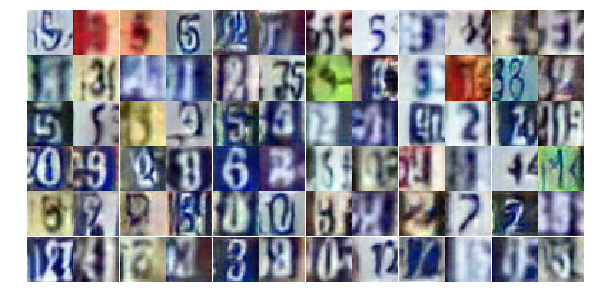

Epoch 14/25... Discriminator Loss: 0.5149... Generator Loss: 1.2125
Epoch 14/25... Discriminator Loss: 0.9645... Generator Loss: 0.9319
Epoch 14/25... Discriminator Loss: 1.1317... Generator Loss: 1.7358
Epoch 14/25... Discriminator Loss: 0.5411... Generator Loss: 1.2128
Epoch 14/25... Discriminator Loss: 0.6071... Generator Loss: 1.6155
Epoch 14/25... Discriminator Loss: 0.7614... Generator Loss: 1.0681
Epoch 14/25... Discriminator Loss: 0.7308... Generator Loss: 0.9771
Epoch 14/25... Discriminator Loss: 0.6194... Generator Loss: 1.0843
Epoch 14/25... Discriminator Loss: 0.6526... Generator Loss: 1.0828
Epoch 14/25... Discriminator Loss: 0.6204... Generator Loss: 1.1481


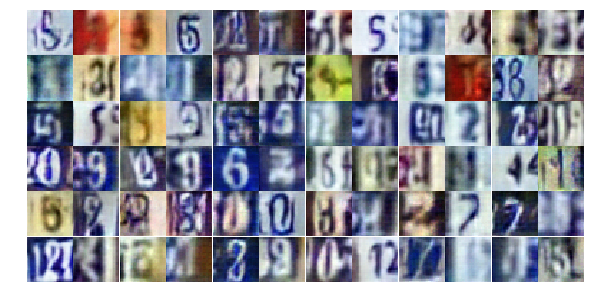

Epoch 14/25... Discriminator Loss: 1.2032... Generator Loss: 0.5548
Epoch 14/25... Discriminator Loss: 0.3428... Generator Loss: 1.6130
Epoch 14/25... Discriminator Loss: 0.5029... Generator Loss: 1.2793
Epoch 14/25... Discriminator Loss: 0.3659... Generator Loss: 1.4970
Epoch 14/25... Discriminator Loss: 0.5146... Generator Loss: 1.2879
Epoch 14/25... Discriminator Loss: 0.6565... Generator Loss: 1.0914
Epoch 14/25... Discriminator Loss: 0.7156... Generator Loss: 0.9797
Epoch 14/25... Discriminator Loss: 0.9506... Generator Loss: 0.6573
Epoch 14/25... Discriminator Loss: 0.3512... Generator Loss: 3.1326
Epoch 14/25... Discriminator Loss: 0.8050... Generator Loss: 0.8447


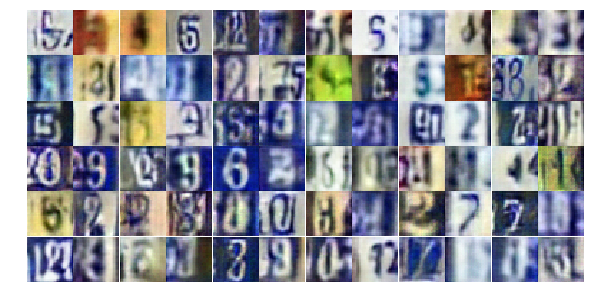

Epoch 14/25... Discriminator Loss: 1.1332... Generator Loss: 0.5148
Epoch 14/25... Discriminator Loss: 0.7364... Generator Loss: 0.9767
Epoch 14/25... Discriminator Loss: 1.0075... Generator Loss: 0.6993
Epoch 14/25... Discriminator Loss: 0.7947... Generator Loss: 0.8933
Epoch 14/25... Discriminator Loss: 0.8414... Generator Loss: 0.8125
Epoch 14/25... Discriminator Loss: 0.6737... Generator Loss: 1.1097
Epoch 14/25... Discriminator Loss: 0.7776... Generator Loss: 0.9276
Epoch 14/25... Discriminator Loss: 0.6225... Generator Loss: 1.5457
Epoch 14/25... Discriminator Loss: 1.1228... Generator Loss: 0.6022
Epoch 14/25... Discriminator Loss: 1.0200... Generator Loss: 0.6671


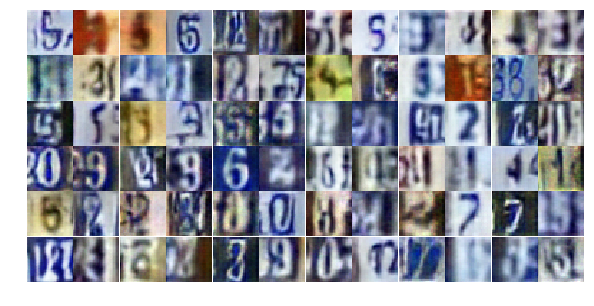

Epoch 14/25... Discriminator Loss: 1.8261... Generator Loss: 4.0750
Epoch 14/25... Discriminator Loss: 0.8800... Generator Loss: 0.9172
Epoch 14/25... Discriminator Loss: 0.9507... Generator Loss: 0.8065
Epoch 14/25... Discriminator Loss: 1.2710... Generator Loss: 0.4732
Epoch 14/25... Discriminator Loss: 0.9319... Generator Loss: 0.8101
Epoch 14/25... Discriminator Loss: 0.7003... Generator Loss: 1.0638
Epoch 14/25... Discriminator Loss: 0.7348... Generator Loss: 1.1269
Epoch 14/25... Discriminator Loss: 0.8041... Generator Loss: 0.8043
Epoch 14/25... Discriminator Loss: 0.8327... Generator Loss: 1.6112
Epoch 14/25... Discriminator Loss: 1.3374... Generator Loss: 0.5013


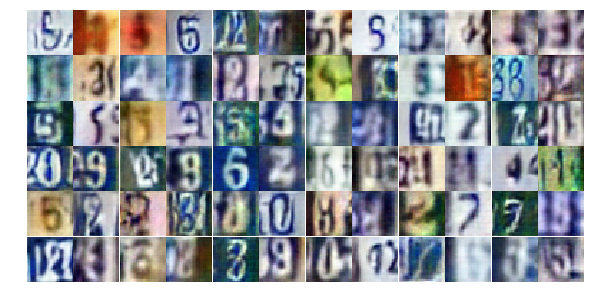

Epoch 14/25... Discriminator Loss: 0.9175... Generator Loss: 0.9206
Epoch 14/25... Discriminator Loss: 0.8845... Generator Loss: 0.7690
Epoch 15/25... Discriminator Loss: 0.7335... Generator Loss: 0.9801
Epoch 15/25... Discriminator Loss: 0.4551... Generator Loss: 1.7465
Epoch 15/25... Discriminator Loss: 0.5784... Generator Loss: 1.3865
Epoch 15/25... Discriminator Loss: 1.1495... Generator Loss: 0.5905
Epoch 15/25... Discriminator Loss: 1.1821... Generator Loss: 0.4979
Epoch 15/25... Discriminator Loss: 0.6241... Generator Loss: 1.0762
Epoch 15/25... Discriminator Loss: 1.1913... Generator Loss: 0.5354
Epoch 15/25... Discriminator Loss: 0.5493... Generator Loss: 1.2938


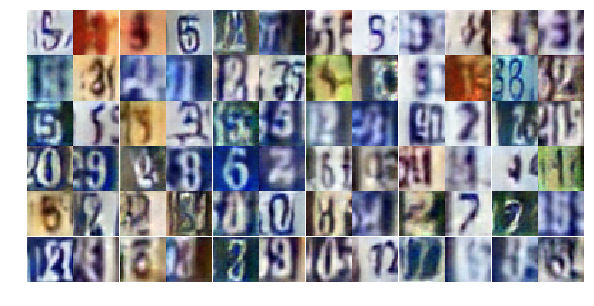

Epoch 15/25... Discriminator Loss: 0.5413... Generator Loss: 1.2973
Epoch 15/25... Discriminator Loss: 0.6155... Generator Loss: 1.2302
Epoch 15/25... Discriminator Loss: 0.8834... Generator Loss: 0.7867
Epoch 15/25... Discriminator Loss: 0.7373... Generator Loss: 0.9154
Epoch 15/25... Discriminator Loss: 0.8761... Generator Loss: 0.8485
Epoch 15/25... Discriminator Loss: 0.5532... Generator Loss: 1.3883
Epoch 15/25... Discriminator Loss: 0.7356... Generator Loss: 0.9098
Epoch 15/25... Discriminator Loss: 0.6724... Generator Loss: 0.9798
Epoch 15/25... Discriminator Loss: 0.9136... Generator Loss: 3.8561
Epoch 15/25... Discriminator Loss: 0.9255... Generator Loss: 0.7598


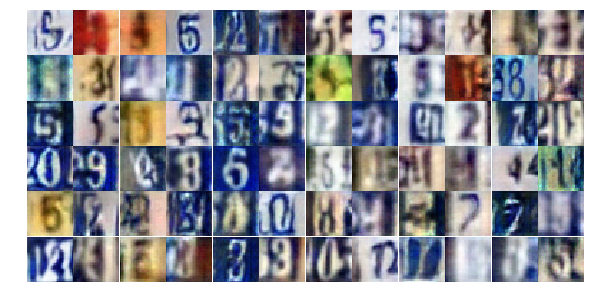

Epoch 15/25... Discriminator Loss: 1.3004... Generator Loss: 0.4507
Epoch 15/25... Discriminator Loss: 0.5835... Generator Loss: 1.2064
Epoch 15/25... Discriminator Loss: 0.5335... Generator Loss: 1.4584
Epoch 15/25... Discriminator Loss: 0.7701... Generator Loss: 0.9194
Epoch 15/25... Discriminator Loss: 1.2329... Generator Loss: 0.4553
Epoch 15/25... Discriminator Loss: 0.5612... Generator Loss: 1.4019
Epoch 15/25... Discriminator Loss: 1.0991... Generator Loss: 0.6604
Epoch 15/25... Discriminator Loss: 0.7358... Generator Loss: 0.9390
Epoch 15/25... Discriminator Loss: 0.5187... Generator Loss: 1.2937
Epoch 15/25... Discriminator Loss: 1.0820... Generator Loss: 0.6537


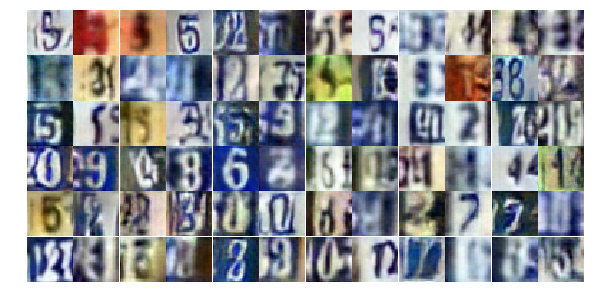

Epoch 15/25... Discriminator Loss: 0.5638... Generator Loss: 1.1880
Epoch 15/25... Discriminator Loss: 0.7590... Generator Loss: 0.8495
Epoch 15/25... Discriminator Loss: 0.3629... Generator Loss: 1.6342
Epoch 15/25... Discriminator Loss: 0.5858... Generator Loss: 1.4016
Epoch 15/25... Discriminator Loss: 0.4704... Generator Loss: 1.4212
Epoch 15/25... Discriminator Loss: 2.2908... Generator Loss: 4.3490
Epoch 15/25... Discriminator Loss: 0.6601... Generator Loss: 1.2120
Epoch 15/25... Discriminator Loss: 0.7108... Generator Loss: 0.9013
Epoch 15/25... Discriminator Loss: 0.5984... Generator Loss: 1.1475
Epoch 15/25... Discriminator Loss: 0.5798... Generator Loss: 1.1939


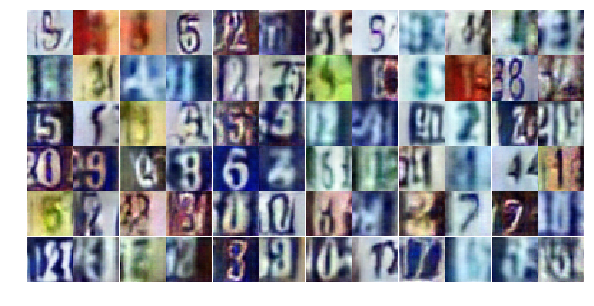

Epoch 15/25... Discriminator Loss: 0.6686... Generator Loss: 1.0443
Epoch 15/25... Discriminator Loss: 1.5370... Generator Loss: 0.3522
Epoch 15/25... Discriminator Loss: 0.8123... Generator Loss: 0.8135
Epoch 15/25... Discriminator Loss: 0.5010... Generator Loss: 1.4518
Epoch 15/25... Discriminator Loss: 0.4907... Generator Loss: 1.2987
Epoch 15/25... Discriminator Loss: 1.4037... Generator Loss: 0.4237
Epoch 15/25... Discriminator Loss: 0.4603... Generator Loss: 1.6841
Epoch 15/25... Discriminator Loss: 0.6739... Generator Loss: 1.8658
Epoch 15/25... Discriminator Loss: 0.5962... Generator Loss: 1.1197
Epoch 15/25... Discriminator Loss: 0.8477... Generator Loss: 1.5335


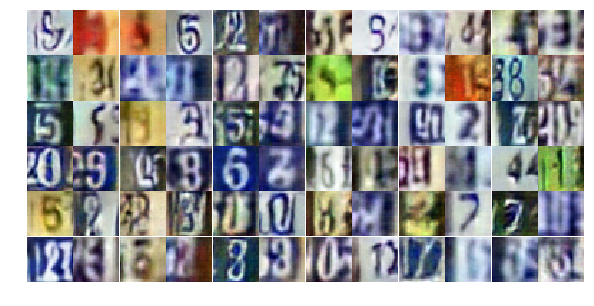

Epoch 15/25... Discriminator Loss: 1.5614... Generator Loss: 0.3495
Epoch 15/25... Discriminator Loss: 2.0573... Generator Loss: 1.7011
Epoch 15/25... Discriminator Loss: 0.6219... Generator Loss: 1.3747
Epoch 15/25... Discriminator Loss: 1.5714... Generator Loss: 0.3308
Epoch 15/25... Discriminator Loss: 0.7911... Generator Loss: 0.8545
Epoch 15/25... Discriminator Loss: 0.9436... Generator Loss: 0.7264
Epoch 15/25... Discriminator Loss: 1.0369... Generator Loss: 0.6027
Epoch 15/25... Discriminator Loss: 0.4715... Generator Loss: 1.6999
Epoch 15/25... Discriminator Loss: 1.3191... Generator Loss: 0.4416
Epoch 16/25... Discriminator Loss: 1.0760... Generator Loss: 0.6472


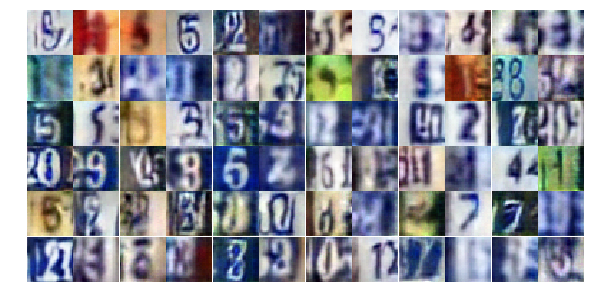

Epoch 16/25... Discriminator Loss: 0.6661... Generator Loss: 1.0410
Epoch 16/25... Discriminator Loss: 0.8759... Generator Loss: 0.8962
Epoch 16/25... Discriminator Loss: 1.0078... Generator Loss: 0.6329
Epoch 16/25... Discriminator Loss: 0.7776... Generator Loss: 0.9360
Epoch 16/25... Discriminator Loss: 0.8688... Generator Loss: 2.7128
Epoch 16/25... Discriminator Loss: 0.9204... Generator Loss: 1.6621
Epoch 16/25... Discriminator Loss: 1.9156... Generator Loss: 0.2281
Epoch 16/25... Discriminator Loss: 0.9020... Generator Loss: 0.6932
Epoch 16/25... Discriminator Loss: 0.9198... Generator Loss: 0.7643
Epoch 16/25... Discriminator Loss: 0.7079... Generator Loss: 0.9766


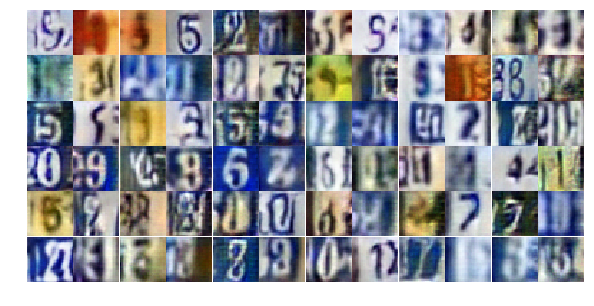

Epoch 16/25... Discriminator Loss: 0.8796... Generator Loss: 0.7328
Epoch 16/25... Discriminator Loss: 0.6948... Generator Loss: 1.0390
Epoch 16/25... Discriminator Loss: 0.6590... Generator Loss: 1.2198
Epoch 16/25... Discriminator Loss: 1.1790... Generator Loss: 0.4928
Epoch 16/25... Discriminator Loss: 0.5119... Generator Loss: 1.3540
Epoch 16/25... Discriminator Loss: 0.7384... Generator Loss: 0.9146
Epoch 16/25... Discriminator Loss: 1.3529... Generator Loss: 0.4537
Epoch 16/25... Discriminator Loss: 0.4880... Generator Loss: 2.1919
Epoch 16/25... Discriminator Loss: 0.6501... Generator Loss: 1.0097
Epoch 16/25... Discriminator Loss: 0.5471... Generator Loss: 1.2697


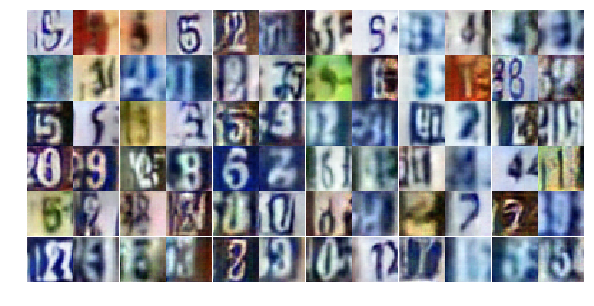

Epoch 16/25... Discriminator Loss: 0.6275... Generator Loss: 1.1142
Epoch 16/25... Discriminator Loss: 0.6466... Generator Loss: 1.7333
Epoch 16/25... Discriminator Loss: 0.9904... Generator Loss: 0.7132
Epoch 16/25... Discriminator Loss: 1.1326... Generator Loss: 0.5679
Epoch 16/25... Discriminator Loss: 0.8670... Generator Loss: 0.7774
Epoch 16/25... Discriminator Loss: 0.8666... Generator Loss: 0.8453
Epoch 16/25... Discriminator Loss: 0.8348... Generator Loss: 0.7983
Epoch 16/25... Discriminator Loss: 0.8315... Generator Loss: 1.0382
Epoch 16/25... Discriminator Loss: 0.8553... Generator Loss: 0.9185
Epoch 16/25... Discriminator Loss: 0.8358... Generator Loss: 0.8276


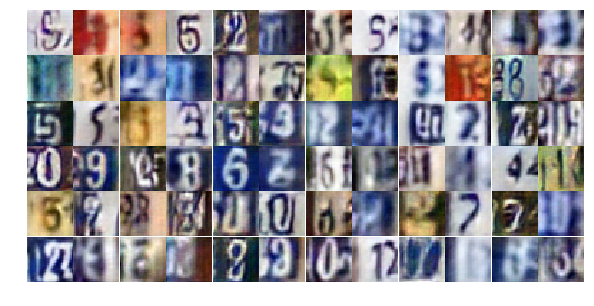

Epoch 16/25... Discriminator Loss: 0.4807... Generator Loss: 1.4103
Epoch 16/25... Discriminator Loss: 0.5187... Generator Loss: 1.2510
Epoch 16/25... Discriminator Loss: 0.5721... Generator Loss: 1.1292
Epoch 16/25... Discriminator Loss: 0.7735... Generator Loss: 1.4932
Epoch 16/25... Discriminator Loss: 1.8132... Generator Loss: 0.2398
Epoch 16/25... Discriminator Loss: 1.2834... Generator Loss: 0.5972
Epoch 16/25... Discriminator Loss: 1.3263... Generator Loss: 0.4278
Epoch 16/25... Discriminator Loss: 1.0993... Generator Loss: 0.6370
Epoch 16/25... Discriminator Loss: 1.0440... Generator Loss: 0.5834
Epoch 16/25... Discriminator Loss: 0.6314... Generator Loss: 0.9913


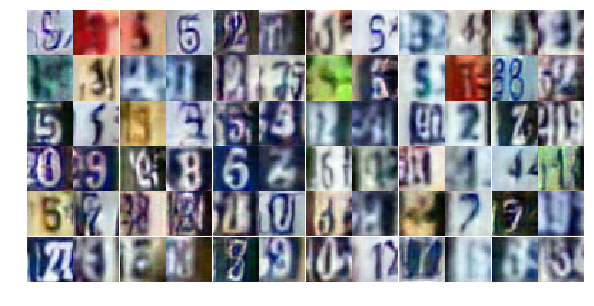

Epoch 16/25... Discriminator Loss: 0.6513... Generator Loss: 1.1813
Epoch 16/25... Discriminator Loss: 0.6919... Generator Loss: 1.1138
Epoch 16/25... Discriminator Loss: 0.8946... Generator Loss: 0.7461
Epoch 16/25... Discriminator Loss: 1.8300... Generator Loss: 0.2393
Epoch 16/25... Discriminator Loss: 0.9163... Generator Loss: 0.7325
Epoch 16/25... Discriminator Loss: 0.9939... Generator Loss: 0.6647
Epoch 16/25... Discriminator Loss: 0.5886... Generator Loss: 1.2742
Epoch 16/25... Discriminator Loss: 0.8213... Generator Loss: 1.5690
Epoch 16/25... Discriminator Loss: 0.5015... Generator Loss: 1.2231
Epoch 16/25... Discriminator Loss: 1.0433... Generator Loss: 0.6629


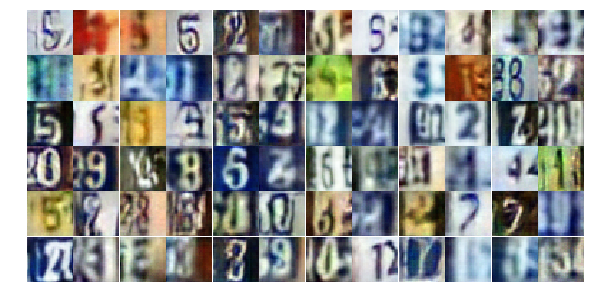

Epoch 16/25... Discriminator Loss: 1.3193... Generator Loss: 0.4284
Epoch 16/25... Discriminator Loss: 1.1443... Generator Loss: 0.6787
Epoch 16/25... Discriminator Loss: 1.7878... Generator Loss: 0.3443
Epoch 16/25... Discriminator Loss: 0.4708... Generator Loss: 1.8250
Epoch 16/25... Discriminator Loss: 0.7378... Generator Loss: 0.8632
Epoch 16/25... Discriminator Loss: 0.6096... Generator Loss: 1.2445
Epoch 17/25... Discriminator Loss: 0.6414... Generator Loss: 1.1373
Epoch 17/25... Discriminator Loss: 0.9466... Generator Loss: 0.7030
Epoch 17/25... Discriminator Loss: 0.6465... Generator Loss: 1.3823
Epoch 17/25... Discriminator Loss: 0.8050... Generator Loss: 0.9683


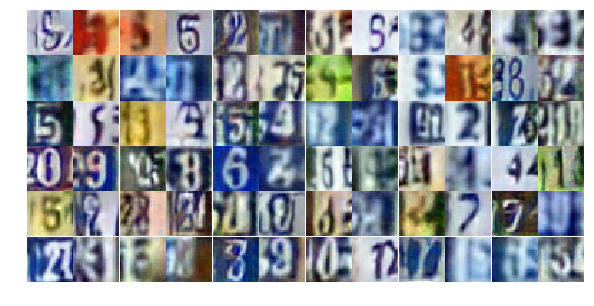

Epoch 17/25... Discriminator Loss: 0.5376... Generator Loss: 1.4175
Epoch 17/25... Discriminator Loss: 0.6427... Generator Loss: 1.1581
Epoch 17/25... Discriminator Loss: 1.0700... Generator Loss: 0.6231
Epoch 17/25... Discriminator Loss: 0.6911... Generator Loss: 0.9382
Epoch 17/25... Discriminator Loss: 1.1021... Generator Loss: 0.5754
Epoch 17/25... Discriminator Loss: 1.0343... Generator Loss: 0.6435
Epoch 17/25... Discriminator Loss: 0.7845... Generator Loss: 0.8998
Epoch 17/25... Discriminator Loss: 0.6216... Generator Loss: 1.0904
Epoch 17/25... Discriminator Loss: 0.3153... Generator Loss: 1.8900
Epoch 17/25... Discriminator Loss: 0.5787... Generator Loss: 1.2704


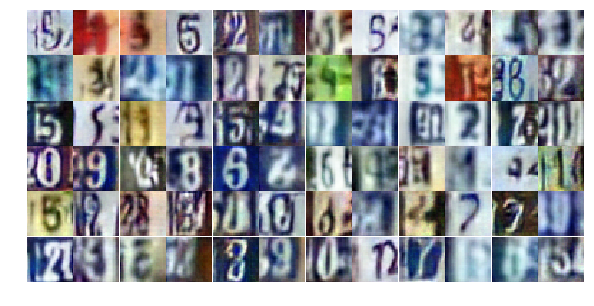

Epoch 17/25... Discriminator Loss: 0.8315... Generator Loss: 1.3315
Epoch 17/25... Discriminator Loss: 0.7645... Generator Loss: 0.9158
Epoch 17/25... Discriminator Loss: 0.5581... Generator Loss: 1.3403
Epoch 17/25... Discriminator Loss: 0.6492... Generator Loss: 1.0829
Epoch 17/25... Discriminator Loss: 0.7625... Generator Loss: 0.9721
Epoch 17/25... Discriminator Loss: 1.2755... Generator Loss: 0.5184
Epoch 17/25... Discriminator Loss: 0.5489... Generator Loss: 1.8131
Epoch 17/25... Discriminator Loss: 0.6370... Generator Loss: 1.1401
Epoch 17/25... Discriminator Loss: 0.6714... Generator Loss: 1.0774
Epoch 17/25... Discriminator Loss: 0.5776... Generator Loss: 1.1084


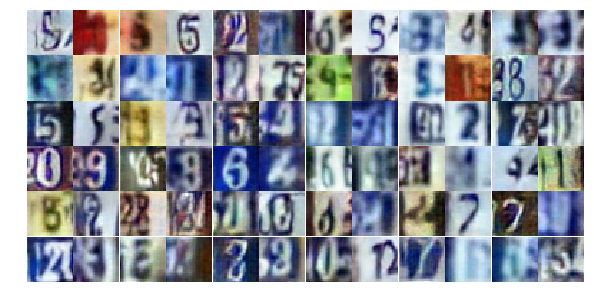

Epoch 17/25... Discriminator Loss: 1.8504... Generator Loss: 0.2672
Epoch 17/25... Discriminator Loss: 0.4159... Generator Loss: 1.8815
Epoch 17/25... Discriminator Loss: 0.5626... Generator Loss: 1.4080
Epoch 17/25... Discriminator Loss: 1.1514... Generator Loss: 0.5856
Epoch 17/25... Discriminator Loss: 1.2429... Generator Loss: 0.4850
Epoch 17/25... Discriminator Loss: 0.4190... Generator Loss: 1.4166
Epoch 17/25... Discriminator Loss: 0.6732... Generator Loss: 0.9901
Epoch 17/25... Discriminator Loss: 0.8542... Generator Loss: 0.8208
Epoch 17/25... Discriminator Loss: 0.6734... Generator Loss: 1.4507
Epoch 17/25... Discriminator Loss: 0.3092... Generator Loss: 1.9007


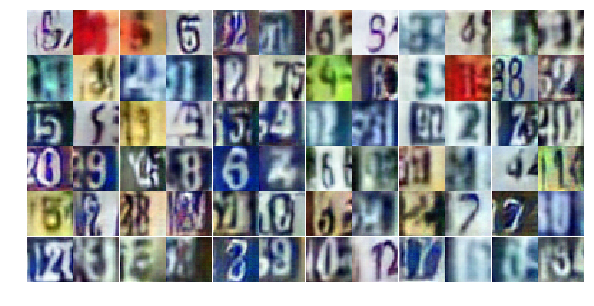

Epoch 17/25... Discriminator Loss: 0.7325... Generator Loss: 1.8128
Epoch 17/25... Discriminator Loss: 1.5816... Generator Loss: 0.3653
Epoch 17/25... Discriminator Loss: 0.5235... Generator Loss: 1.8557
Epoch 17/25... Discriminator Loss: 0.7564... Generator Loss: 1.4832
Epoch 17/25... Discriminator Loss: 1.1158... Generator Loss: 0.5721
Epoch 17/25... Discriminator Loss: 0.5787... Generator Loss: 1.2538
Epoch 17/25... Discriminator Loss: 0.7574... Generator Loss: 1.3274
Epoch 17/25... Discriminator Loss: 0.6575... Generator Loss: 1.0533
Epoch 17/25... Discriminator Loss: 0.3123... Generator Loss: 1.7049
Epoch 17/25... Discriminator Loss: 0.7631... Generator Loss: 0.9040


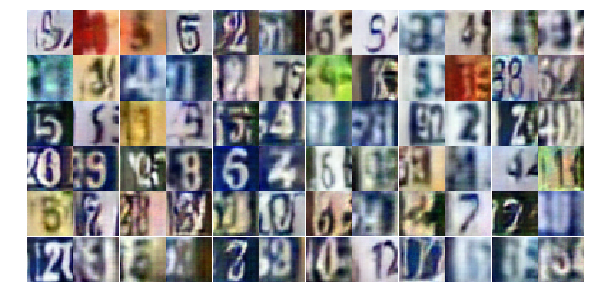

Epoch 17/25... Discriminator Loss: 3.8528... Generator Loss: 0.0413
Epoch 17/25... Discriminator Loss: 2.2682... Generator Loss: 2.7352
Epoch 17/25... Discriminator Loss: 1.8293... Generator Loss: 1.8937
Epoch 17/25... Discriminator Loss: 0.9525... Generator Loss: 1.9520
Epoch 17/25... Discriminator Loss: 1.1488... Generator Loss: 1.7367
Epoch 17/25... Discriminator Loss: 0.9446... Generator Loss: 1.3127
Epoch 17/25... Discriminator Loss: 1.0252... Generator Loss: 0.6912
Epoch 17/25... Discriminator Loss: 1.1946... Generator Loss: 0.5304
Epoch 17/25... Discriminator Loss: 0.6297... Generator Loss: 1.2884
Epoch 17/25... Discriminator Loss: 1.1917... Generator Loss: 0.5407


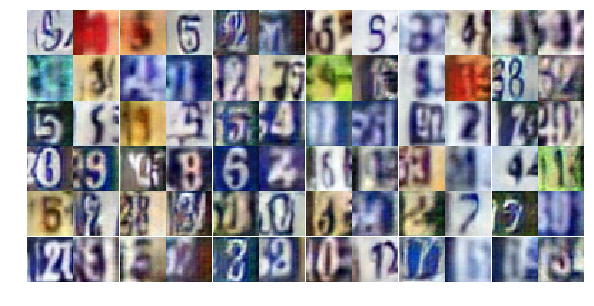

Epoch 17/25... Discriminator Loss: 0.7501... Generator Loss: 1.6869
Epoch 17/25... Discriminator Loss: 1.0088... Generator Loss: 0.6528
Epoch 17/25... Discriminator Loss: 0.4132... Generator Loss: 1.6131
Epoch 17/25... Discriminator Loss: 0.7559... Generator Loss: 1.4587
Epoch 18/25... Discriminator Loss: 0.9390... Generator Loss: 0.7237
Epoch 18/25... Discriminator Loss: 0.9177... Generator Loss: 0.7441
Epoch 18/25... Discriminator Loss: 0.9718... Generator Loss: 0.6778
Epoch 18/25... Discriminator Loss: 0.6565... Generator Loss: 1.2193
Epoch 18/25... Discriminator Loss: 0.9617... Generator Loss: 0.7606
Epoch 18/25... Discriminator Loss: 0.7445... Generator Loss: 0.9784


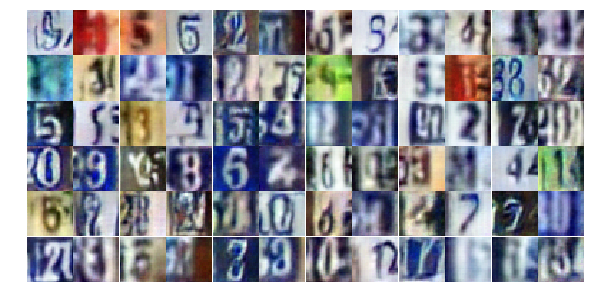

Epoch 18/25... Discriminator Loss: 0.4371... Generator Loss: 1.3683
Epoch 18/25... Discriminator Loss: 0.9835... Generator Loss: 0.6597
Epoch 18/25... Discriminator Loss: 1.0368... Generator Loss: 0.5777
Epoch 18/25... Discriminator Loss: 0.5048... Generator Loss: 1.4635
Epoch 18/25... Discriminator Loss: 0.6037... Generator Loss: 1.2225
Epoch 18/25... Discriminator Loss: 1.1574... Generator Loss: 0.5256
Epoch 18/25... Discriminator Loss: 0.5509... Generator Loss: 1.3197
Epoch 18/25... Discriminator Loss: 0.6160... Generator Loss: 1.0974
Epoch 18/25... Discriminator Loss: 0.8352... Generator Loss: 0.7486
Epoch 18/25... Discriminator Loss: 0.3688... Generator Loss: 1.7396


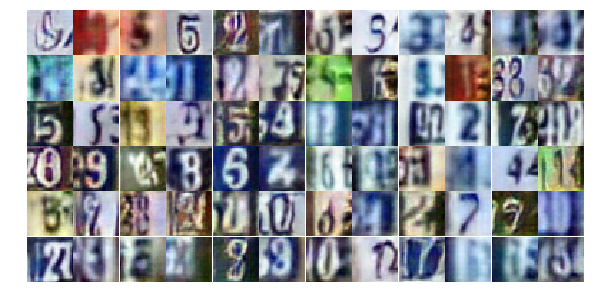

Epoch 18/25... Discriminator Loss: 0.5908... Generator Loss: 1.2593
Epoch 18/25... Discriminator Loss: 0.8527... Generator Loss: 0.8543
Epoch 18/25... Discriminator Loss: 1.2371... Generator Loss: 0.4828
Epoch 18/25... Discriminator Loss: 0.6689... Generator Loss: 1.0483
Epoch 18/25... Discriminator Loss: 0.6896... Generator Loss: 0.9256
Epoch 18/25... Discriminator Loss: 0.6792... Generator Loss: 1.0232
Epoch 18/25... Discriminator Loss: 0.8002... Generator Loss: 1.0821
Epoch 18/25... Discriminator Loss: 0.8880... Generator Loss: 0.7631
Epoch 18/25... Discriminator Loss: 0.6541... Generator Loss: 1.1419
Epoch 18/25... Discriminator Loss: 0.8059... Generator Loss: 0.7811


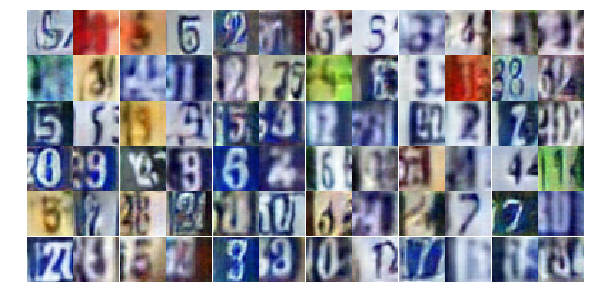

Epoch 18/25... Discriminator Loss: 0.6599... Generator Loss: 1.0289
Epoch 18/25... Discriminator Loss: 0.6865... Generator Loss: 1.0825
Epoch 18/25... Discriminator Loss: 0.8180... Generator Loss: 0.7716
Epoch 18/25... Discriminator Loss: 0.8347... Generator Loss: 0.8589
Epoch 18/25... Discriminator Loss: 1.3206... Generator Loss: 0.4245
Epoch 18/25... Discriminator Loss: 0.7601... Generator Loss: 0.9839
Epoch 18/25... Discriminator Loss: 0.7684... Generator Loss: 0.9134
Epoch 18/25... Discriminator Loss: 0.3609... Generator Loss: 1.8857
Epoch 18/25... Discriminator Loss: 0.5837... Generator Loss: 1.1000
Epoch 18/25... Discriminator Loss: 0.6355... Generator Loss: 1.1907


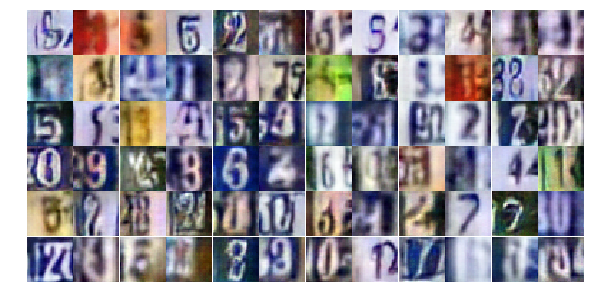

Epoch 18/25... Discriminator Loss: 0.6896... Generator Loss: 1.1915
Epoch 18/25... Discriminator Loss: 0.8018... Generator Loss: 0.7942
Epoch 18/25... Discriminator Loss: 0.5932... Generator Loss: 1.1018
Epoch 18/25... Discriminator Loss: 0.6279... Generator Loss: 1.0860
Epoch 18/25... Discriminator Loss: 0.9037... Generator Loss: 0.8346
Epoch 18/25... Discriminator Loss: 0.3879... Generator Loss: 1.5882
Epoch 18/25... Discriminator Loss: 0.9182... Generator Loss: 0.7304
Epoch 18/25... Discriminator Loss: 0.7515... Generator Loss: 1.4839
Epoch 18/25... Discriminator Loss: 1.2104... Generator Loss: 0.5014
Epoch 18/25... Discriminator Loss: 0.3951... Generator Loss: 1.9690


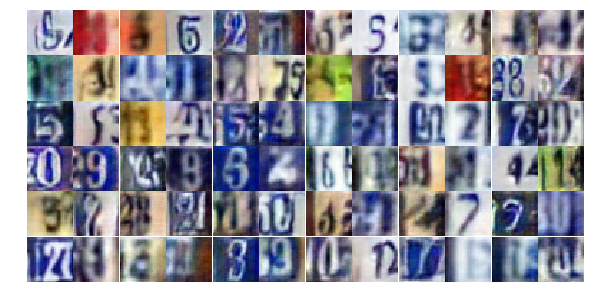

Epoch 18/25... Discriminator Loss: 0.8661... Generator Loss: 1.0169
Epoch 18/25... Discriminator Loss: 0.9407... Generator Loss: 0.8152
Epoch 18/25... Discriminator Loss: 0.6215... Generator Loss: 1.5788
Epoch 18/25... Discriminator Loss: 0.9628... Generator Loss: 0.7617
Epoch 18/25... Discriminator Loss: 0.9743... Generator Loss: 0.6222
Epoch 18/25... Discriminator Loss: 0.8605... Generator Loss: 0.7879
Epoch 18/25... Discriminator Loss: 0.8200... Generator Loss: 0.7862
Epoch 18/25... Discriminator Loss: 0.4333... Generator Loss: 1.5851
Epoch 18/25... Discriminator Loss: 0.8455... Generator Loss: 1.0165
Epoch 18/25... Discriminator Loss: 1.5627... Generator Loss: 0.3243


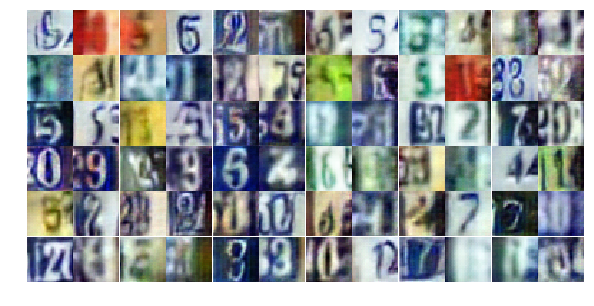

Epoch 18/25... Discriminator Loss: 1.2735... Generator Loss: 2.5174
Epoch 19/25... Discriminator Loss: 0.8948... Generator Loss: 1.3965
Epoch 19/25... Discriminator Loss: 1.0127... Generator Loss: 0.6261
Epoch 19/25... Discriminator Loss: 1.2148... Generator Loss: 0.5163
Epoch 19/25... Discriminator Loss: 0.8715... Generator Loss: 0.7981
Epoch 19/25... Discriminator Loss: 0.8420... Generator Loss: 0.8596
Epoch 19/25... Discriminator Loss: 0.7919... Generator Loss: 0.8371
Epoch 19/25... Discriminator Loss: 0.8042... Generator Loss: 1.1973
Epoch 19/25... Discriminator Loss: 0.6919... Generator Loss: 1.6230
Epoch 19/25... Discriminator Loss: 1.0659... Generator Loss: 0.5933


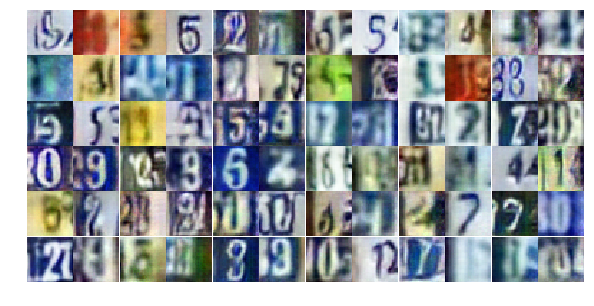

Epoch 19/25... Discriminator Loss: 0.8624... Generator Loss: 0.7665
Epoch 19/25... Discriminator Loss: 0.6572... Generator Loss: 1.1474
Epoch 19/25... Discriminator Loss: 0.8071... Generator Loss: 0.8756
Epoch 19/25... Discriminator Loss: 1.1583... Generator Loss: 0.5341
Epoch 19/25... Discriminator Loss: 0.9095... Generator Loss: 0.6846
Epoch 19/25... Discriminator Loss: 0.7056... Generator Loss: 1.2213
Epoch 19/25... Discriminator Loss: 1.1281... Generator Loss: 0.5950
Epoch 19/25... Discriminator Loss: 0.7805... Generator Loss: 0.7941
Epoch 19/25... Discriminator Loss: 0.7395... Generator Loss: 0.9889
Epoch 19/25... Discriminator Loss: 1.1328... Generator Loss: 0.5513


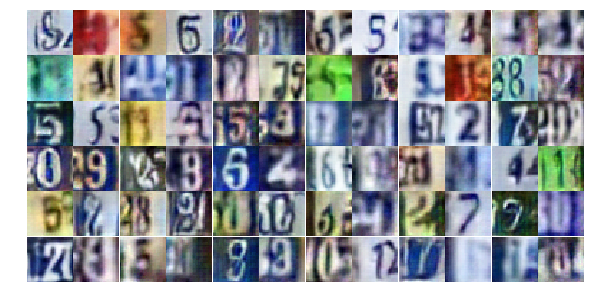

Epoch 19/25... Discriminator Loss: 0.7898... Generator Loss: 0.8607
Epoch 19/25... Discriminator Loss: 1.6605... Generator Loss: 0.2898
Epoch 19/25... Discriminator Loss: 1.5658... Generator Loss: 0.3329
Epoch 19/25... Discriminator Loss: 0.8956... Generator Loss: 0.8112
Epoch 19/25... Discriminator Loss: 1.0903... Generator Loss: 0.6207
Epoch 19/25... Discriminator Loss: 0.7367... Generator Loss: 1.0468
Epoch 19/25... Discriminator Loss: 0.5775... Generator Loss: 1.1894
Epoch 19/25... Discriminator Loss: 0.6843... Generator Loss: 0.9702
Epoch 19/25... Discriminator Loss: 1.2385... Generator Loss: 0.5199
Epoch 19/25... Discriminator Loss: 0.8787... Generator Loss: 0.8463


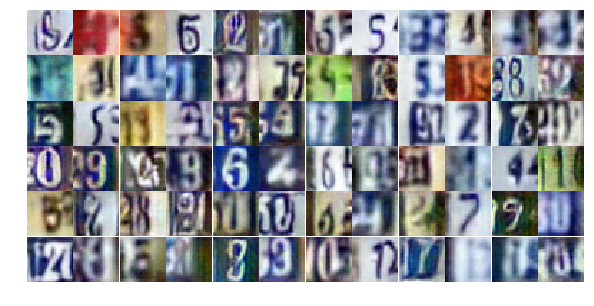

Epoch 19/25... Discriminator Loss: 0.9112... Generator Loss: 0.7025
Epoch 19/25... Discriminator Loss: 0.6672... Generator Loss: 1.0293
Epoch 19/25... Discriminator Loss: 0.8375... Generator Loss: 0.8098
Epoch 19/25... Discriminator Loss: 0.7757... Generator Loss: 0.9126
Epoch 19/25... Discriminator Loss: 0.6315... Generator Loss: 1.2430
Epoch 19/25... Discriminator Loss: 1.5434... Generator Loss: 0.3444
Epoch 19/25... Discriminator Loss: 0.6166... Generator Loss: 1.4685
Epoch 19/25... Discriminator Loss: 0.4659... Generator Loss: 1.6031
Epoch 19/25... Discriminator Loss: 0.9291... Generator Loss: 0.7444
Epoch 19/25... Discriminator Loss: 0.5815... Generator Loss: 1.2582


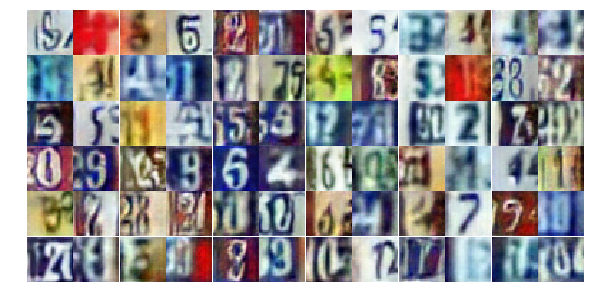

Epoch 19/25... Discriminator Loss: 0.7977... Generator Loss: 0.9488
Epoch 19/25... Discriminator Loss: 0.8715... Generator Loss: 0.8545
Epoch 19/25... Discriminator Loss: 0.8997... Generator Loss: 0.7440
Epoch 19/25... Discriminator Loss: 0.6051... Generator Loss: 1.1071
Epoch 19/25... Discriminator Loss: 0.7056... Generator Loss: 1.5231
Epoch 19/25... Discriminator Loss: 0.5092... Generator Loss: 2.2565
Epoch 19/25... Discriminator Loss: 0.6609... Generator Loss: 1.2234
Epoch 19/25... Discriminator Loss: 0.5485... Generator Loss: 1.4481
Epoch 19/25... Discriminator Loss: 0.7199... Generator Loss: 1.1446
Epoch 19/25... Discriminator Loss: 0.8293... Generator Loss: 1.0150


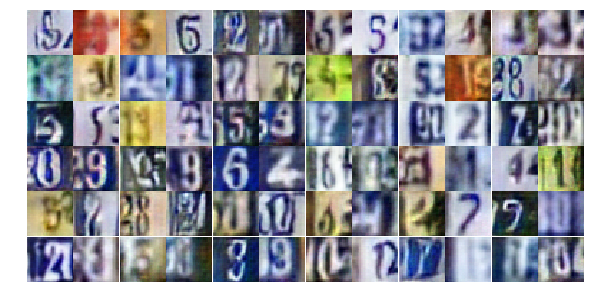

Epoch 19/25... Discriminator Loss: 0.7595... Generator Loss: 1.1304
Epoch 19/25... Discriminator Loss: 0.8823... Generator Loss: 0.8088
Epoch 19/25... Discriminator Loss: 0.6076... Generator Loss: 2.0431
Epoch 19/25... Discriminator Loss: 0.8199... Generator Loss: 0.8188
Epoch 19/25... Discriminator Loss: 0.8936... Generator Loss: 2.0958
Epoch 19/25... Discriminator Loss: 0.6034... Generator Loss: 1.6009
Epoch 19/25... Discriminator Loss: 1.8455... Generator Loss: 0.2606
Epoch 19/25... Discriminator Loss: 0.6058... Generator Loss: 1.1930
Epoch 20/25... Discriminator Loss: 0.6783... Generator Loss: 1.1464
Epoch 20/25... Discriminator Loss: 0.8057... Generator Loss: 0.8919


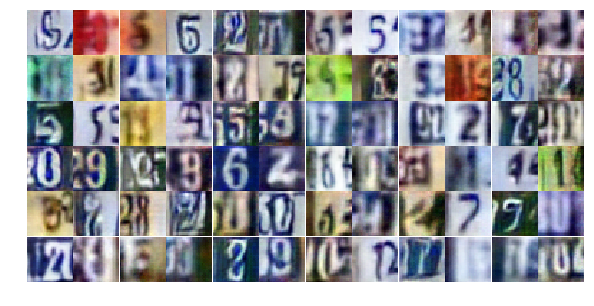

Epoch 20/25... Discriminator Loss: 1.1016... Generator Loss: 0.5648
Epoch 20/25... Discriminator Loss: 1.1416... Generator Loss: 0.6148
Epoch 20/25... Discriminator Loss: 1.1690... Generator Loss: 0.5367
Epoch 20/25... Discriminator Loss: 1.0681... Generator Loss: 0.6037
Epoch 20/25... Discriminator Loss: 0.6284... Generator Loss: 1.3035
Epoch 20/25... Discriminator Loss: 0.7229... Generator Loss: 1.0024
Epoch 20/25... Discriminator Loss: 1.0049... Generator Loss: 0.7089
Epoch 20/25... Discriminator Loss: 0.6906... Generator Loss: 1.0973
Epoch 20/25... Discriminator Loss: 0.8764... Generator Loss: 0.7025
Epoch 20/25... Discriminator Loss: 0.7155... Generator Loss: 0.8935


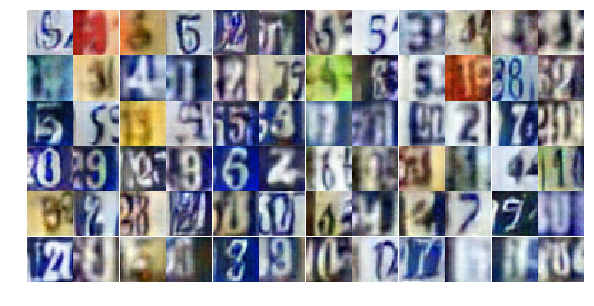

Epoch 20/25... Discriminator Loss: 1.2746... Generator Loss: 0.4669
Epoch 20/25... Discriminator Loss: 1.0921... Generator Loss: 0.6696
Epoch 20/25... Discriminator Loss: 0.7010... Generator Loss: 1.0847
Epoch 20/25... Discriminator Loss: 1.0570... Generator Loss: 0.6795
Epoch 20/25... Discriminator Loss: 1.3280... Generator Loss: 0.4419
Epoch 20/25... Discriminator Loss: 1.1797... Generator Loss: 0.4968
Epoch 20/25... Discriminator Loss: 1.6370... Generator Loss: 0.3384
Epoch 20/25... Discriminator Loss: 0.6603... Generator Loss: 1.3641
Epoch 20/25... Discriminator Loss: 0.7357... Generator Loss: 0.9230
Epoch 20/25... Discriminator Loss: 1.4491... Generator Loss: 0.4197


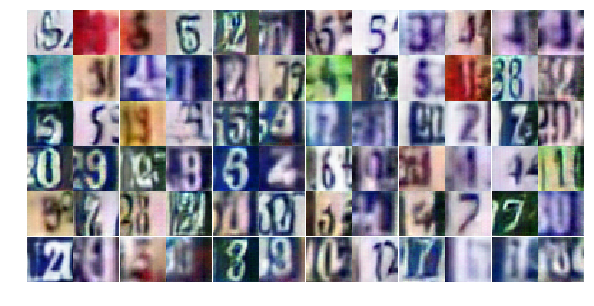

Epoch 20/25... Discriminator Loss: 0.8261... Generator Loss: 0.7951
Epoch 20/25... Discriminator Loss: 0.8515... Generator Loss: 0.8105
Epoch 20/25... Discriminator Loss: 0.3519... Generator Loss: 2.9977
Epoch 20/25... Discriminator Loss: 1.6195... Generator Loss: 0.3657
Epoch 20/25... Discriminator Loss: 1.5989... Generator Loss: 0.3441
Epoch 20/25... Discriminator Loss: 0.6098... Generator Loss: 1.2086
Epoch 20/25... Discriminator Loss: 0.5292... Generator Loss: 1.4125
Epoch 20/25... Discriminator Loss: 1.3396... Generator Loss: 0.4884
Epoch 20/25... Discriminator Loss: 0.9610... Generator Loss: 0.6919
Epoch 20/25... Discriminator Loss: 0.4873... Generator Loss: 1.2524


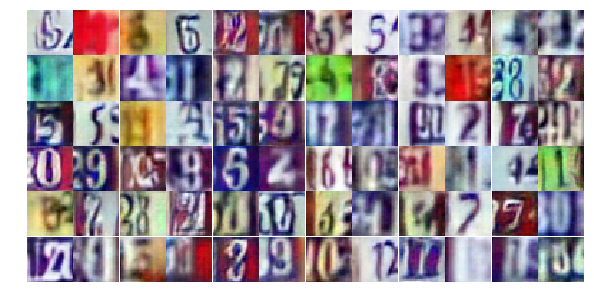

Epoch 20/25... Discriminator Loss: 0.7514... Generator Loss: 1.0001
Epoch 20/25... Discriminator Loss: 0.6122... Generator Loss: 1.1082
Epoch 20/25... Discriminator Loss: 1.0190... Generator Loss: 0.6043
Epoch 20/25... Discriminator Loss: 0.6580... Generator Loss: 1.1484
Epoch 20/25... Discriminator Loss: 0.8885... Generator Loss: 0.8785
Epoch 20/25... Discriminator Loss: 1.4398... Generator Loss: 0.4056
Epoch 20/25... Discriminator Loss: 1.2582... Generator Loss: 0.5241
Epoch 20/25... Discriminator Loss: 1.0055... Generator Loss: 0.7591
Epoch 20/25... Discriminator Loss: 0.5415... Generator Loss: 1.4800
Epoch 20/25... Discriminator Loss: 0.6411... Generator Loss: 1.0779


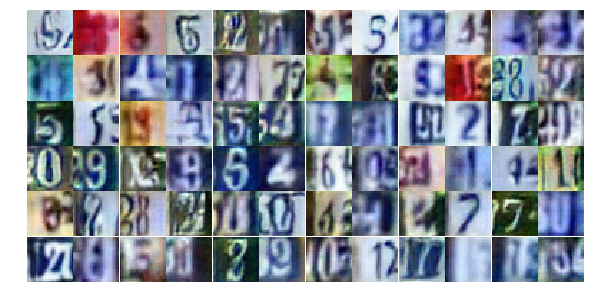

Epoch 20/25... Discriminator Loss: 1.1405... Generator Loss: 0.6452
Epoch 20/25... Discriminator Loss: 0.7569... Generator Loss: 0.8901
Epoch 20/25... Discriminator Loss: 0.6802... Generator Loss: 1.2334
Epoch 20/25... Discriminator Loss: 1.0142... Generator Loss: 0.7477
Epoch 20/25... Discriminator Loss: 1.0701... Generator Loss: 0.6502
Epoch 20/25... Discriminator Loss: 1.1188... Generator Loss: 0.5645
Epoch 20/25... Discriminator Loss: 0.9008... Generator Loss: 0.7654
Epoch 20/25... Discriminator Loss: 0.5398... Generator Loss: 1.2049
Epoch 20/25... Discriminator Loss: 0.8434... Generator Loss: 0.8058
Epoch 20/25... Discriminator Loss: 0.7295... Generator Loss: 0.9699


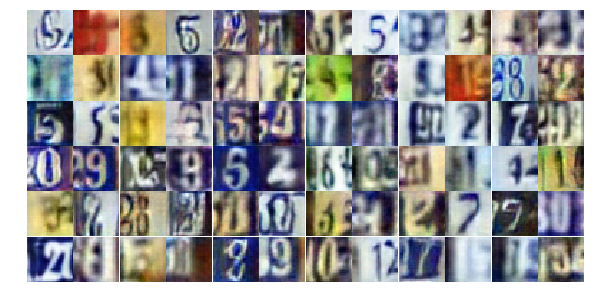

Epoch 20/25... Discriminator Loss: 0.5166... Generator Loss: 1.5068
Epoch 20/25... Discriminator Loss: 0.6846... Generator Loss: 1.9379
Epoch 20/25... Discriminator Loss: 0.4081... Generator Loss: 1.5853
Epoch 20/25... Discriminator Loss: 1.0494... Generator Loss: 0.6279
Epoch 20/25... Discriminator Loss: 0.6397... Generator Loss: 1.0580
Epoch 20/25... Discriminator Loss: 0.5080... Generator Loss: 1.4474
Epoch 21/25... Discriminator Loss: 0.8447... Generator Loss: 0.9637
Epoch 21/25... Discriminator Loss: 0.9192... Generator Loss: 0.6884
Epoch 21/25... Discriminator Loss: 1.4666... Generator Loss: 0.4302
Epoch 21/25... Discriminator Loss: 1.2063... Generator Loss: 0.5076


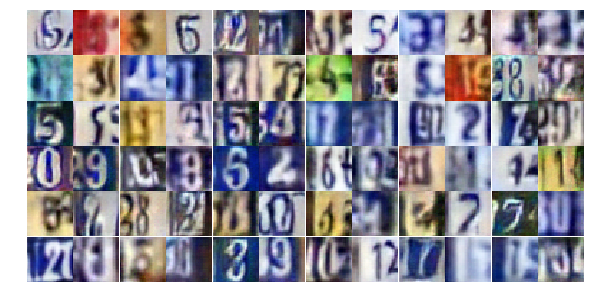

Epoch 21/25... Discriminator Loss: 0.6782... Generator Loss: 1.1921
Epoch 21/25... Discriminator Loss: 1.7580... Generator Loss: 0.3600
Epoch 21/25... Discriminator Loss: 0.5192... Generator Loss: 1.3735
Epoch 21/25... Discriminator Loss: 0.4889... Generator Loss: 1.3280
Epoch 21/25... Discriminator Loss: 0.6949... Generator Loss: 1.0345
Epoch 21/25... Discriminator Loss: 0.5135... Generator Loss: 1.4793
Epoch 21/25... Discriminator Loss: 0.7644... Generator Loss: 1.0091
Epoch 21/25... Discriminator Loss: 0.6727... Generator Loss: 1.1467
Epoch 21/25... Discriminator Loss: 0.7018... Generator Loss: 0.9768
Epoch 21/25... Discriminator Loss: 0.7582... Generator Loss: 1.0437


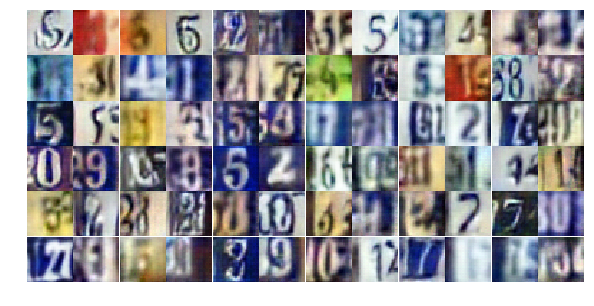

Epoch 21/25... Discriminator Loss: 0.3803... Generator Loss: 1.8444
Epoch 21/25... Discriminator Loss: 0.9806... Generator Loss: 0.6325
Epoch 21/25... Discriminator Loss: 1.4693... Generator Loss: 0.3997
Epoch 21/25... Discriminator Loss: 0.6805... Generator Loss: 2.0699
Epoch 21/25... Discriminator Loss: 0.4408... Generator Loss: 1.8799
Epoch 21/25... Discriminator Loss: 1.1254... Generator Loss: 0.5574
Epoch 21/25... Discriminator Loss: 0.7159... Generator Loss: 1.0563
Epoch 21/25... Discriminator Loss: 0.3709... Generator Loss: 2.0173
Epoch 21/25... Discriminator Loss: 0.5133... Generator Loss: 1.2595
Epoch 21/25... Discriminator Loss: 0.6490... Generator Loss: 1.0233


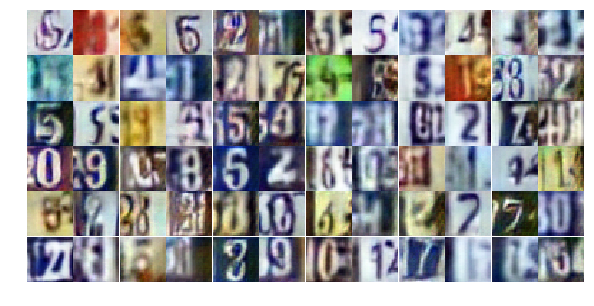

Epoch 21/25... Discriminator Loss: 0.9497... Generator Loss: 0.7912
Epoch 21/25... Discriminator Loss: 0.4047... Generator Loss: 1.5107
Epoch 21/25... Discriminator Loss: 1.4299... Generator Loss: 0.4164
Epoch 21/25... Discriminator Loss: 1.0075... Generator Loss: 0.6240
Epoch 21/25... Discriminator Loss: 0.7395... Generator Loss: 0.9387
Epoch 21/25... Discriminator Loss: 1.1491... Generator Loss: 0.5704
Epoch 21/25... Discriminator Loss: 0.5837... Generator Loss: 1.1417
Epoch 21/25... Discriminator Loss: 0.9281... Generator Loss: 0.6789
Epoch 21/25... Discriminator Loss: 0.9256... Generator Loss: 0.7410
Epoch 21/25... Discriminator Loss: 1.8843... Generator Loss: 0.2656


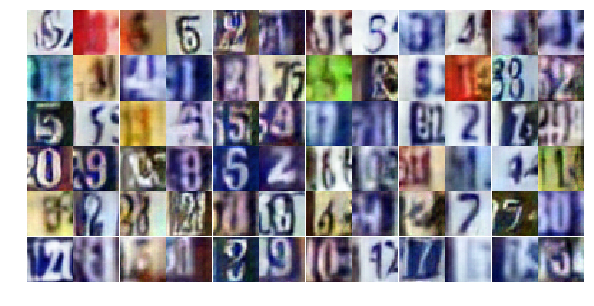

Epoch 21/25... Discriminator Loss: 1.5335... Generator Loss: 0.3393
Epoch 21/25... Discriminator Loss: 0.7168... Generator Loss: 1.7548
Epoch 21/25... Discriminator Loss: 0.9024... Generator Loss: 0.9072
Epoch 21/25... Discriminator Loss: 0.5485... Generator Loss: 1.1923
Epoch 21/25... Discriminator Loss: 0.5905... Generator Loss: 1.1396
Epoch 21/25... Discriminator Loss: 0.6491... Generator Loss: 1.1071
Epoch 21/25... Discriminator Loss: 0.9576... Generator Loss: 0.6731
Epoch 21/25... Discriminator Loss: 1.5229... Generator Loss: 0.4017
Epoch 21/25... Discriminator Loss: 0.7496... Generator Loss: 0.8941
Epoch 21/25... Discriminator Loss: 0.2561... Generator Loss: 2.4456


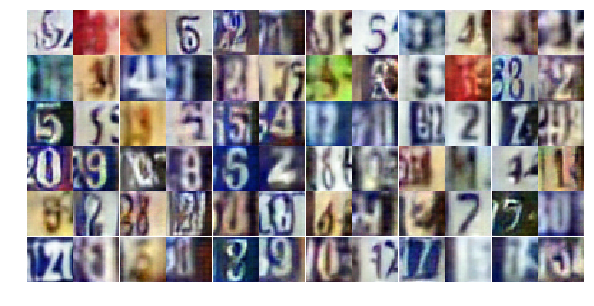

Epoch 21/25... Discriminator Loss: 0.6350... Generator Loss: 1.1381
Epoch 21/25... Discriminator Loss: 1.4505... Generator Loss: 0.4266
Epoch 21/25... Discriminator Loss: 0.4919... Generator Loss: 1.3470
Epoch 21/25... Discriminator Loss: 0.8924... Generator Loss: 1.0128
Epoch 21/25... Discriminator Loss: 0.2945... Generator Loss: 2.3953
Epoch 21/25... Discriminator Loss: 0.9181... Generator Loss: 0.7566
Epoch 21/25... Discriminator Loss: 0.8138... Generator Loss: 0.8697
Epoch 21/25... Discriminator Loss: 1.1881... Generator Loss: 0.5122
Epoch 21/25... Discriminator Loss: 0.9935... Generator Loss: 0.6774
Epoch 21/25... Discriminator Loss: 0.8087... Generator Loss: 1.2275


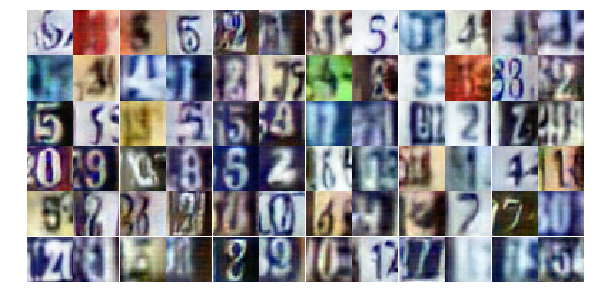

Epoch 21/25... Discriminator Loss: 0.6479... Generator Loss: 1.3931
Epoch 21/25... Discriminator Loss: 1.5199... Generator Loss: 0.3630
Epoch 21/25... Discriminator Loss: 0.8214... Generator Loss: 1.0279
Epoch 22/25... Discriminator Loss: 1.2033... Generator Loss: 2.0472
Epoch 22/25... Discriminator Loss: 0.9255... Generator Loss: 0.7278
Epoch 22/25... Discriminator Loss: 1.1717... Generator Loss: 0.5587
Epoch 22/25... Discriminator Loss: 0.6681... Generator Loss: 1.0896
Epoch 22/25... Discriminator Loss: 0.6514... Generator Loss: 1.0885
Epoch 22/25... Discriminator Loss: 0.7254... Generator Loss: 0.9918
Epoch 22/25... Discriminator Loss: 0.8632... Generator Loss: 0.8187


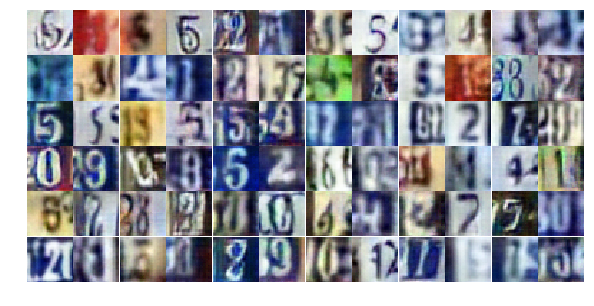

Epoch 22/25... Discriminator Loss: 0.6736... Generator Loss: 1.9141
Epoch 22/25... Discriminator Loss: 0.7988... Generator Loss: 0.8712
Epoch 22/25... Discriminator Loss: 1.2384... Generator Loss: 0.4917
Epoch 22/25... Discriminator Loss: 0.5633... Generator Loss: 1.5648
Epoch 22/25... Discriminator Loss: 0.8442... Generator Loss: 0.8369
Epoch 22/25... Discriminator Loss: 0.6300... Generator Loss: 1.1113
Epoch 22/25... Discriminator Loss: 0.9221... Generator Loss: 0.7313
Epoch 22/25... Discriminator Loss: 0.4518... Generator Loss: 1.5029
Epoch 22/25... Discriminator Loss: 1.0176... Generator Loss: 0.6364
Epoch 22/25... Discriminator Loss: 1.8595... Generator Loss: 0.2579


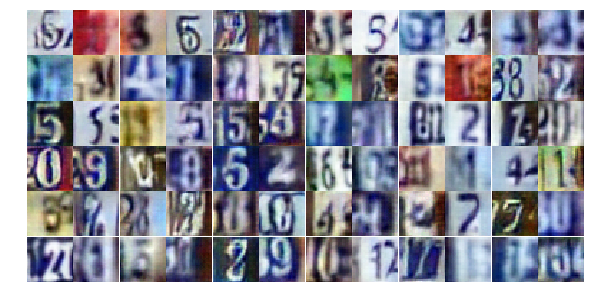

Epoch 22/25... Discriminator Loss: 0.5623... Generator Loss: 1.7927
Epoch 22/25... Discriminator Loss: 0.7031... Generator Loss: 0.9673
Epoch 22/25... Discriminator Loss: 0.8610... Generator Loss: 0.7336
Epoch 22/25... Discriminator Loss: 0.6516... Generator Loss: 1.1089
Epoch 22/25... Discriminator Loss: 0.4284... Generator Loss: 1.5830
Epoch 22/25... Discriminator Loss: 1.0085... Generator Loss: 0.6664
Epoch 22/25... Discriminator Loss: 0.4568... Generator Loss: 1.4683
Epoch 22/25... Discriminator Loss: 0.4473... Generator Loss: 1.9167
Epoch 22/25... Discriminator Loss: 0.8469... Generator Loss: 0.7870
Epoch 22/25... Discriminator Loss: 0.6576... Generator Loss: 0.9915


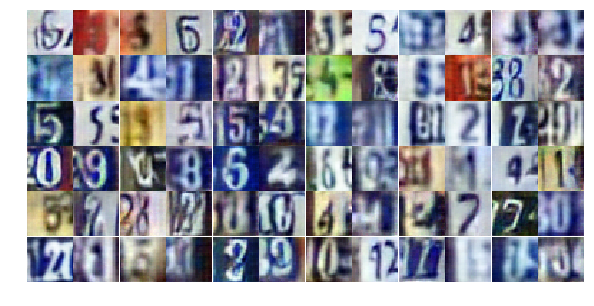

Epoch 22/25... Discriminator Loss: 0.3966... Generator Loss: 1.6920
Epoch 22/25... Discriminator Loss: 0.8186... Generator Loss: 0.8339
Epoch 22/25... Discriminator Loss: 0.9415... Generator Loss: 0.7006
Epoch 22/25... Discriminator Loss: 0.6650... Generator Loss: 1.0451
Epoch 22/25... Discriminator Loss: 1.0351... Generator Loss: 0.6173
Epoch 22/25... Discriminator Loss: 0.9101... Generator Loss: 0.7171
Epoch 22/25... Discriminator Loss: 1.4346... Generator Loss: 0.4166
Epoch 22/25... Discriminator Loss: 0.5053... Generator Loss: 1.7459
Epoch 22/25... Discriminator Loss: 0.7609... Generator Loss: 1.0489
Epoch 22/25... Discriminator Loss: 1.2343... Generator Loss: 0.5395


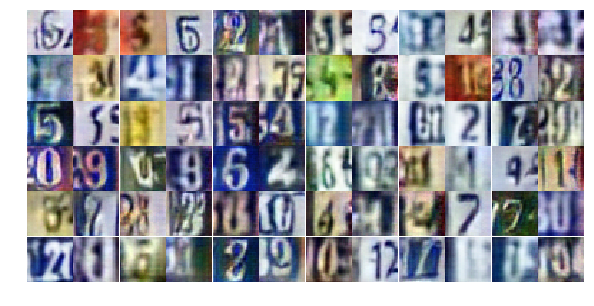

Epoch 22/25... Discriminator Loss: 1.2888... Generator Loss: 0.5225
Epoch 22/25... Discriminator Loss: 0.5603... Generator Loss: 1.4187
Epoch 22/25... Discriminator Loss: 0.5120... Generator Loss: 1.1858
Epoch 22/25... Discriminator Loss: 0.6885... Generator Loss: 1.0018
Epoch 22/25... Discriminator Loss: 0.5875... Generator Loss: 1.0583
Epoch 22/25... Discriminator Loss: 0.5152... Generator Loss: 1.2271
Epoch 22/25... Discriminator Loss: 0.9591... Generator Loss: 0.6921
Epoch 22/25... Discriminator Loss: 0.5272... Generator Loss: 1.4006
Epoch 22/25... Discriminator Loss: 1.1050... Generator Loss: 0.6709
Epoch 22/25... Discriminator Loss: 0.8206... Generator Loss: 0.9353


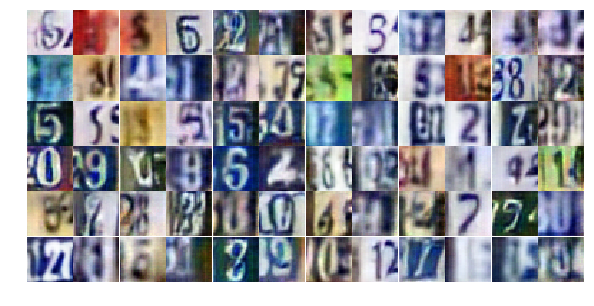

Epoch 22/25... Discriminator Loss: 1.0701... Generator Loss: 0.6002
Epoch 22/25... Discriminator Loss: 0.6254... Generator Loss: 1.1257
Epoch 22/25... Discriminator Loss: 0.9440... Generator Loss: 0.6828
Epoch 22/25... Discriminator Loss: 1.0793... Generator Loss: 0.7141
Epoch 22/25... Discriminator Loss: 0.8074... Generator Loss: 0.9084
Epoch 22/25... Discriminator Loss: 0.5568... Generator Loss: 2.1258
Epoch 22/25... Discriminator Loss: 1.7853... Generator Loss: 0.2711
Epoch 22/25... Discriminator Loss: 0.6018... Generator Loss: 1.2386
Epoch 22/25... Discriminator Loss: 0.8482... Generator Loss: 2.2871
Epoch 22/25... Discriminator Loss: 0.9454... Generator Loss: 0.7169


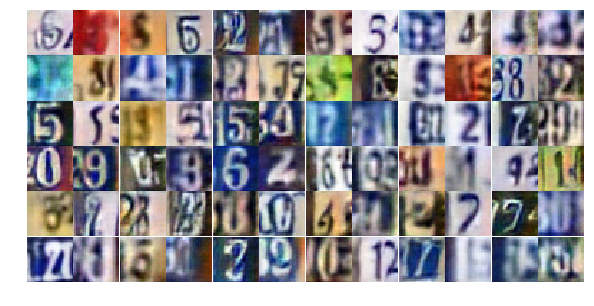

Epoch 23/25... Discriminator Loss: 0.6175... Generator Loss: 1.2317
Epoch 23/25... Discriminator Loss: 0.3880... Generator Loss: 1.5015
Epoch 23/25... Discriminator Loss: 0.9936... Generator Loss: 0.6957
Epoch 23/25... Discriminator Loss: 0.6001... Generator Loss: 1.2452
Epoch 23/25... Discriminator Loss: 1.1553... Generator Loss: 0.5680
Epoch 23/25... Discriminator Loss: 0.8672... Generator Loss: 0.9635
Epoch 23/25... Discriminator Loss: 1.2918... Generator Loss: 0.5287
Epoch 23/25... Discriminator Loss: 0.6971... Generator Loss: 1.0334
Epoch 23/25... Discriminator Loss: 0.7067... Generator Loss: 0.9276
Epoch 23/25... Discriminator Loss: 0.4798... Generator Loss: 1.3815


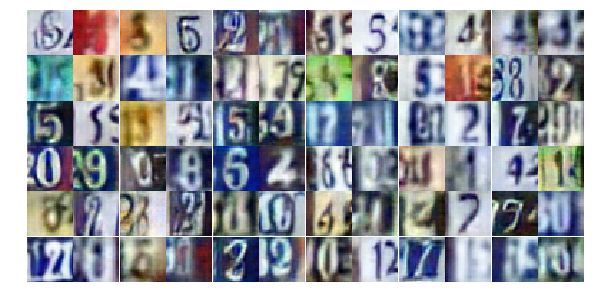

Epoch 23/25... Discriminator Loss: 0.6235... Generator Loss: 1.0849
Epoch 23/25... Discriminator Loss: 0.6567... Generator Loss: 1.0178
Epoch 23/25... Discriminator Loss: 0.5610... Generator Loss: 1.8146
Epoch 23/25... Discriminator Loss: 0.6075... Generator Loss: 1.2646
Epoch 23/25... Discriminator Loss: 0.4896... Generator Loss: 1.3658
Epoch 23/25... Discriminator Loss: 0.6554... Generator Loss: 1.0820
Epoch 23/25... Discriminator Loss: 0.7122... Generator Loss: 1.0987
Epoch 23/25... Discriminator Loss: 0.6772... Generator Loss: 1.0551
Epoch 23/25... Discriminator Loss: 0.8162... Generator Loss: 0.8623
Epoch 23/25... Discriminator Loss: 0.7546... Generator Loss: 1.0190


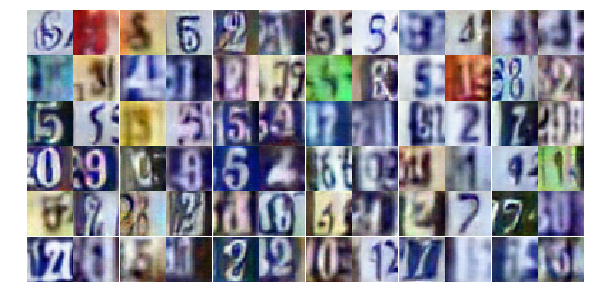

Epoch 23/25... Discriminator Loss: 1.1935... Generator Loss: 0.5652
Epoch 23/25... Discriminator Loss: 5.1090... Generator Loss: 7.6280
Epoch 23/25... Discriminator Loss: 1.7722... Generator Loss: 2.9477
Epoch 23/25... Discriminator Loss: 1.0092... Generator Loss: 3.2020
Epoch 23/25... Discriminator Loss: 0.6440... Generator Loss: 1.9486
Epoch 23/25... Discriminator Loss: 1.0166... Generator Loss: 0.8234
Epoch 23/25... Discriminator Loss: 0.6921... Generator Loss: 1.1443
Epoch 23/25... Discriminator Loss: 0.8092... Generator Loss: 0.9433
Epoch 23/25... Discriminator Loss: 0.6200... Generator Loss: 1.2774
Epoch 23/25... Discriminator Loss: 1.0088... Generator Loss: 0.9420


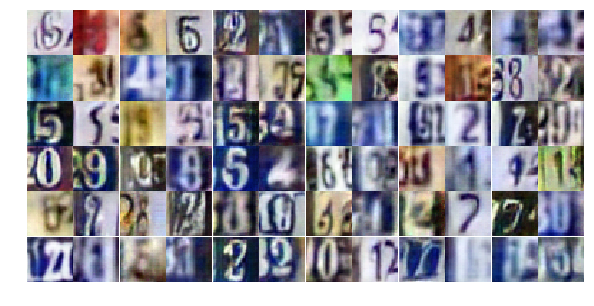

Epoch 23/25... Discriminator Loss: 0.5571... Generator Loss: 1.1672
Epoch 23/25... Discriminator Loss: 0.6110... Generator Loss: 1.3127
Epoch 23/25... Discriminator Loss: 0.6180... Generator Loss: 1.3273
Epoch 23/25... Discriminator Loss: 1.3054... Generator Loss: 0.4489
Epoch 23/25... Discriminator Loss: 0.8877... Generator Loss: 0.9361
Epoch 23/25... Discriminator Loss: 1.1448... Generator Loss: 0.5626
Epoch 23/25... Discriminator Loss: 1.1246... Generator Loss: 0.5656
Epoch 23/25... Discriminator Loss: 0.7525... Generator Loss: 0.8667
Epoch 23/25... Discriminator Loss: 0.4812... Generator Loss: 1.7129
Epoch 23/25... Discriminator Loss: 0.5285... Generator Loss: 1.2972


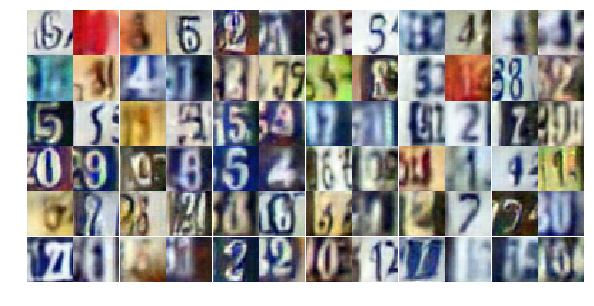

Epoch 23/25... Discriminator Loss: 0.8576... Generator Loss: 0.9185
Epoch 23/25... Discriminator Loss: 0.8628... Generator Loss: 0.8480
Epoch 23/25... Discriminator Loss: 1.2471... Generator Loss: 0.5832
Epoch 23/25... Discriminator Loss: 0.9281... Generator Loss: 0.7726
Epoch 23/25... Discriminator Loss: 0.9414... Generator Loss: 0.8258
Epoch 23/25... Discriminator Loss: 1.1248... Generator Loss: 0.5611
Epoch 23/25... Discriminator Loss: 0.8800... Generator Loss: 0.8953
Epoch 23/25... Discriminator Loss: 1.4491... Generator Loss: 0.5722
Epoch 23/25... Discriminator Loss: 0.9482... Generator Loss: 0.7308
Epoch 23/25... Discriminator Loss: 0.8104... Generator Loss: 0.8745


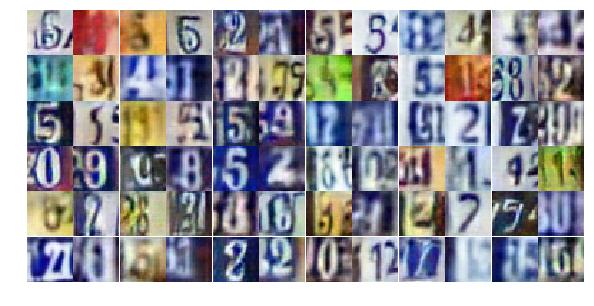

Epoch 23/25... Discriminator Loss: 0.6318... Generator Loss: 1.0885
Epoch 23/25... Discriminator Loss: 1.4520... Generator Loss: 0.3693
Epoch 23/25... Discriminator Loss: 1.5653... Generator Loss: 0.3334
Epoch 23/25... Discriminator Loss: 0.5355... Generator Loss: 1.0977
Epoch 23/25... Discriminator Loss: 1.3407... Generator Loss: 0.4840
Epoch 23/25... Discriminator Loss: 0.6474... Generator Loss: 1.1689
Epoch 23/25... Discriminator Loss: 1.1107... Generator Loss: 0.5074
Epoch 24/25... Discriminator Loss: 0.5618... Generator Loss: 1.1910
Epoch 24/25... Discriminator Loss: 0.6646... Generator Loss: 1.3081
Epoch 24/25... Discriminator Loss: 1.3108... Generator Loss: 0.5198


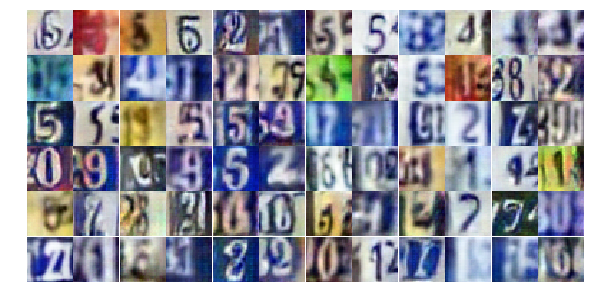

Epoch 24/25... Discriminator Loss: 0.4376... Generator Loss: 1.6542
Epoch 24/25... Discriminator Loss: 0.6645... Generator Loss: 1.0459
Epoch 24/25... Discriminator Loss: 1.0540... Generator Loss: 0.6121
Epoch 24/25... Discriminator Loss: 0.7905... Generator Loss: 1.7066
Epoch 24/25... Discriminator Loss: 1.5217... Generator Loss: 0.4195
Epoch 24/25... Discriminator Loss: 0.5259... Generator Loss: 1.5507
Epoch 24/25... Discriminator Loss: 1.4901... Generator Loss: 0.3789
Epoch 24/25... Discriminator Loss: 1.2125... Generator Loss: 0.4902
Epoch 24/25... Discriminator Loss: 0.3223... Generator Loss: 1.7310
Epoch 24/25... Discriminator Loss: 0.3955... Generator Loss: 1.8242


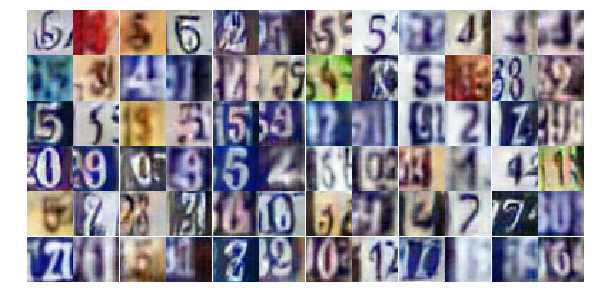

Epoch 24/25... Discriminator Loss: 0.9995... Generator Loss: 0.6217
Epoch 24/25... Discriminator Loss: 1.6168... Generator Loss: 0.3252
Epoch 24/25... Discriminator Loss: 1.0811... Generator Loss: 0.6152
Epoch 24/25... Discriminator Loss: 0.5961... Generator Loss: 1.0509
Epoch 24/25... Discriminator Loss: 0.9277... Generator Loss: 2.8304
Epoch 24/25... Discriminator Loss: 0.8292... Generator Loss: 0.9815
Epoch 24/25... Discriminator Loss: 0.6796... Generator Loss: 1.0232
Epoch 24/25... Discriminator Loss: 0.9735... Generator Loss: 0.7246
Epoch 24/25... Discriminator Loss: 0.6858... Generator Loss: 1.1469
Epoch 24/25... Discriminator Loss: 0.8226... Generator Loss: 0.8834


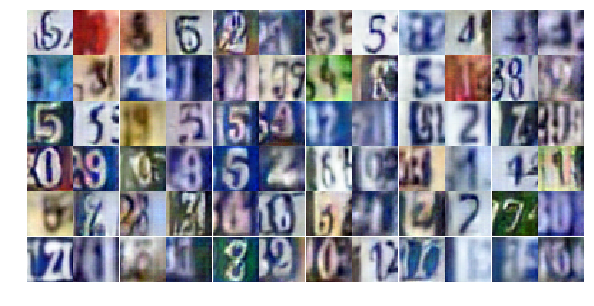

Epoch 24/25... Discriminator Loss: 0.6087... Generator Loss: 1.1275
Epoch 24/25... Discriminator Loss: 0.7313... Generator Loss: 0.9683
Epoch 24/25... Discriminator Loss: 0.4967... Generator Loss: 1.3598
Epoch 24/25... Discriminator Loss: 1.4321... Generator Loss: 0.4559
Epoch 24/25... Discriminator Loss: 0.7111... Generator Loss: 0.9441
Epoch 24/25... Discriminator Loss: 0.4502... Generator Loss: 1.4069
Epoch 24/25... Discriminator Loss: 0.5589... Generator Loss: 1.0352
Epoch 24/25... Discriminator Loss: 0.5178... Generator Loss: 1.9049
Epoch 24/25... Discriminator Loss: 0.9577... Generator Loss: 0.7632
Epoch 24/25... Discriminator Loss: 0.8995... Generator Loss: 0.7527


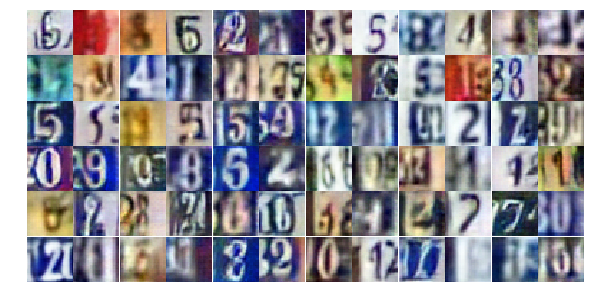

Epoch 24/25... Discriminator Loss: 0.4931... Generator Loss: 1.3056
Epoch 24/25... Discriminator Loss: 0.5894... Generator Loss: 1.2003
Epoch 24/25... Discriminator Loss: 1.3043... Generator Loss: 0.5488
Epoch 24/25... Discriminator Loss: 1.7163... Generator Loss: 0.2949
Epoch 24/25... Discriminator Loss: 1.0738... Generator Loss: 0.6859
Epoch 24/25... Discriminator Loss: 0.8880... Generator Loss: 0.7657
Epoch 24/25... Discriminator Loss: 1.0999... Generator Loss: 0.6014
Epoch 24/25... Discriminator Loss: 0.8881... Generator Loss: 0.7595
Epoch 24/25... Discriminator Loss: 0.7183... Generator Loss: 1.1287
Epoch 24/25... Discriminator Loss: 0.6517... Generator Loss: 1.2867


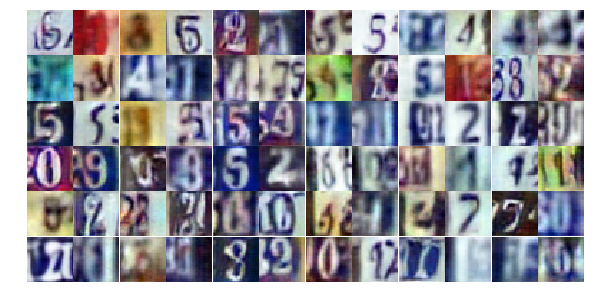

Epoch 24/25... Discriminator Loss: 0.7037... Generator Loss: 0.9455
Epoch 24/25... Discriminator Loss: 3.0648... Generator Loss: 0.0966
Epoch 24/25... Discriminator Loss: 0.9279... Generator Loss: 1.1396
Epoch 24/25... Discriminator Loss: 0.9102... Generator Loss: 1.1412
Epoch 24/25... Discriminator Loss: 1.1398... Generator Loss: 0.6090
Epoch 24/25... Discriminator Loss: 0.7034... Generator Loss: 1.0157
Epoch 24/25... Discriminator Loss: 1.0384... Generator Loss: 0.6699
Epoch 24/25... Discriminator Loss: 0.5241... Generator Loss: 1.4675
Epoch 24/25... Discriminator Loss: 0.8544... Generator Loss: 0.8437
Epoch 24/25... Discriminator Loss: 1.0763... Generator Loss: 0.7293


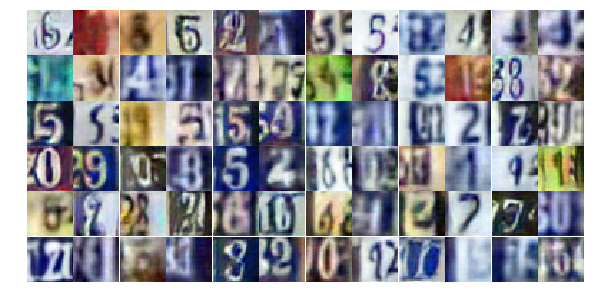

Epoch 24/25... Discriminator Loss: 1.2603... Generator Loss: 0.5363
Epoch 24/25... Discriminator Loss: 1.4280... Generator Loss: 0.4724
Epoch 24/25... Discriminator Loss: 1.3531... Generator Loss: 0.4956
Epoch 24/25... Discriminator Loss: 0.6551... Generator Loss: 1.2539
Epoch 24/25... Discriminator Loss: 1.0540... Generator Loss: 0.7422
Epoch 25/25... Discriminator Loss: 0.5150... Generator Loss: 1.5118
Epoch 25/25... Discriminator Loss: 0.6198... Generator Loss: 1.3667
Epoch 25/25... Discriminator Loss: 0.8824... Generator Loss: 0.9272
Epoch 25/25... Discriminator Loss: 0.8055... Generator Loss: 0.8316


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))